# Progress:

### 1. Evaluation of parameters
* Trained differen convolutional and recurrent NN models
* Tested hyperparameters systematically with csv file and with genetic programming (but tended to make only fully connected layers)
* Best accuracy 64% 

### 2. Coordinate trajectories
* Investigate data by plotting mean and different examples of joints by pitch type

### 3. Testing different interpolation/smoothing
* Filling in missing values does not work properly
* Tried different filters (Kalmann, Gaussian, Cubic and linear interpolation) to fill in the values and smoothen the curve
* Problem: Sometimes the outliers are actually the right values
* Used LSTM to learn coordinate trajectories to fill in missing values, works but not plotted yet

### 4. One script from video to pitch type/other inferences
* Aim: in the end one system for real time inferences from videos
* stitched together Estelle's preprocessing and my model
* Problem with tensorflow pytorch compatability
* Evaluated times for different steps

### IN ON VIDEOS notebook:
* Maybe loss of information when getting the coordinates - therefore trained LSTM directly on videos
* up to 50% Acc
* possible todo: try 3D conv net

# 1. Evaluation of parameters

In [1]:
import pandas as pd
import numpy as np
import tensorflow as tf
import scipy as sp
import scipy.stats

#from sklearn.preprocessing import StandardScaler
from data_preprocess import Preprocessor
from tools import Tools
from model import Model
import matplotlib.pylab as plt

import shutil

In [ ]:
df = pd.read_csv("test_parameters.csv")
columns = df.columns.tolist()
print(columns)

In [ ]:

#df = df.sort_values(by = "highest_acc")
#print(len(df))
#df = df.drop(df.index[range(450)])
#acc = df["highest_acc"].values
print(acc)
columns = ['Batchsize', 'align', 'dropout', 'file', 'learning_rate', 'len_train', 
           'model', 'nr_classes', 'optimizer', 'regularization', 
           '1st_conv_filters', '1st_conv_kernel', '2nd_conv_filter', '2nd_conv_kernel', '1st_hidden_dense', 
           '2nd_hidden_dense']
#'lstm_hidden_layers', 'lstm_units', 

plt.rcParams.update({'font.size': 18})
for col in columns:
    act = np.unique(df[col].values)
    cut = [np.mean((df[df[col]==elem])["highest_acc"].values) for elem in act]

    plt.figure()
    plt.ylim([0.5,0.65])
    y_pos = range(len(act))
    plt.bar(y_pos, cut, align='center', alpha=0.5, width = 0.5)
    #plt.ylim([0,350])
    plt.xticks(y_pos, act)
    plt.ylabel('highest test accuracy achieved')
    plt.title(col)
    plt.show()

## Try to relate two different parametes to each other

In [ ]:
from matplotlib import cm
from matplotlib.ticker import LinearLocator, FormatStrFormatter
from mpl_toolkits.mplot3d import Axes3D
fig = plt.figure()
ax = fig.gca(projection='3d')
X = df["1st_conv_filters"].values
Y = df['1st_conv_kernel'].values
#X, Y = np.meshgrid(X, Y)
ax = fig.add_subplot(111, projection='3d')
surf = ax.plot(X, Y, df["highest_acc"].values)
#fig.colorbar(surf, shrink=0.5, aspect=5)
plt.show()

# 2. Coordinate trajectories

In [63]:
import numpy as np
data = np.load("interpolated.npy")

In [64]:
from data_preprocess import Preprocessor
pre = Preprocessor("cf_data.csv")
pre.remove_small_classes(50)
#NEW
a, stat = pre.get_list_with_most("Pitcher")
print(a)
pre.cut_file_to_pitcher(a[0])
data = pre.get_coord_arr(None)

labels = pre.get_labels()
print(data.shape)
print(labels.shape)

/Users/ninawiedemann/anaconda/lib/python3.5/site-packages/IPython/core/interactiveshell.py:2821: DtypeWarning: Columns (253,254,255,256,257,258,259,289) have mixed types. Specify dtype option on import or set low_memory=False.
  if self.run_code(code, result):


csv eingelesen with length  13150
Only Pitcher rows
[['Changeup' 491]
 ['Curveball' 627]
 ['Eephus' 1]
 ['Fastball (2-seam)' 1341]
 ['Fastball (4-seam)' 2075]
 ['Fastball (Cut)' 287]
 ['Fastball (Split-finger)' 49]
 ['Knuckle curve' 73]
 ['Knuckleball' 350]
 ['Sinker' 265]
 ['Slider' 913]
 ['Unknown Pitch Type' 103]]
Removed because not enought class members:  ['Eephus' 'Fastball (Split-finger)'] Unknown Pitch Type
[527054.0, 285079.0, 592314.0, 448802.0, 656794.0]
(463, 167, 18, 2)
(463,)


In [65]:
unique = np.unique(labels)
index_liste = []
for pitches in unique:
    index_liste.append(np.where(labels==pitches))

## Plot mean

All pitch types  std_sum:  0 number:  463


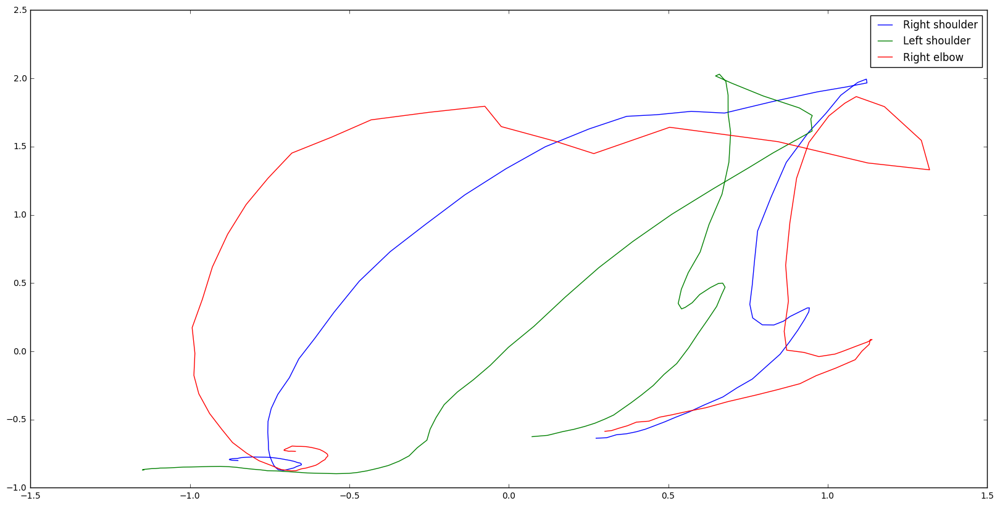

Changeup std_sum:  0 anzahl:  29


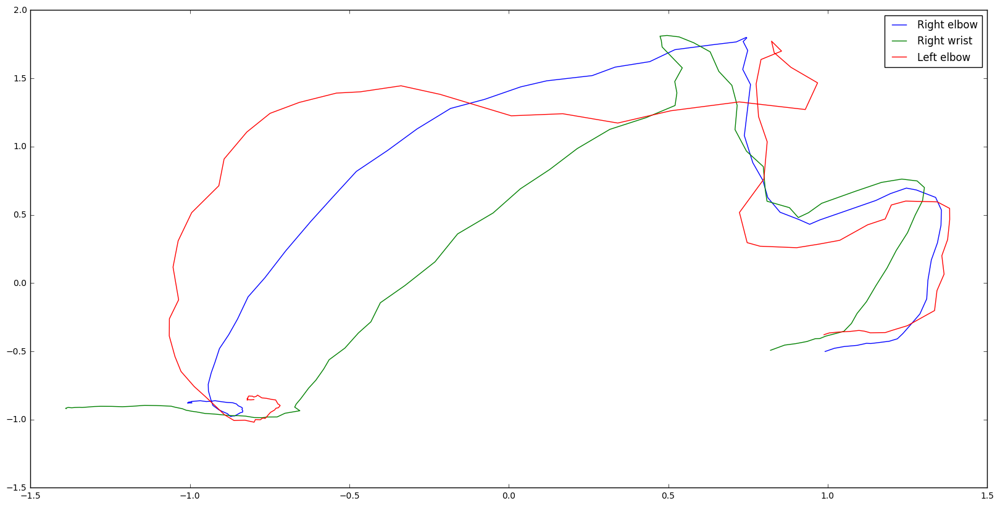

Curveball std_sum:  0 anzahl:  39


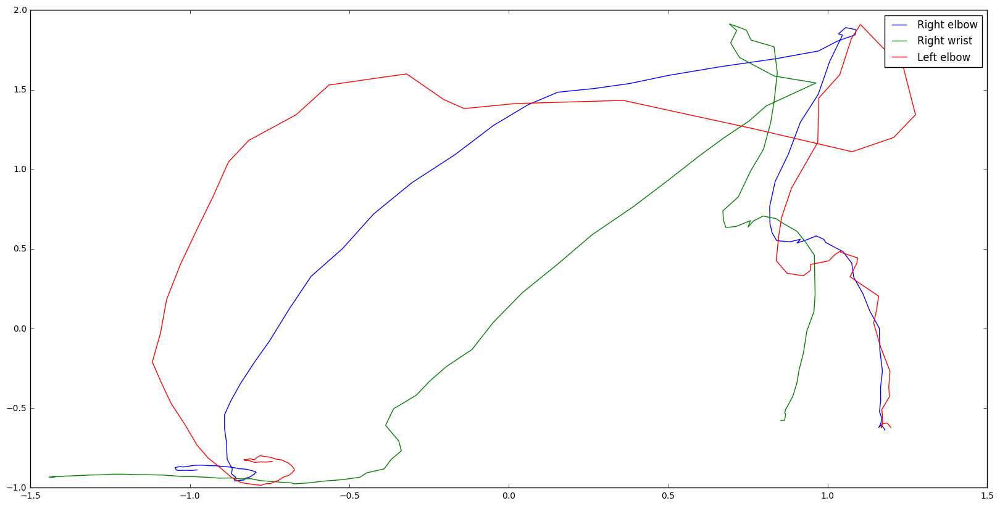

Fastball (2-seam) std_sum:  0 anzahl:  82


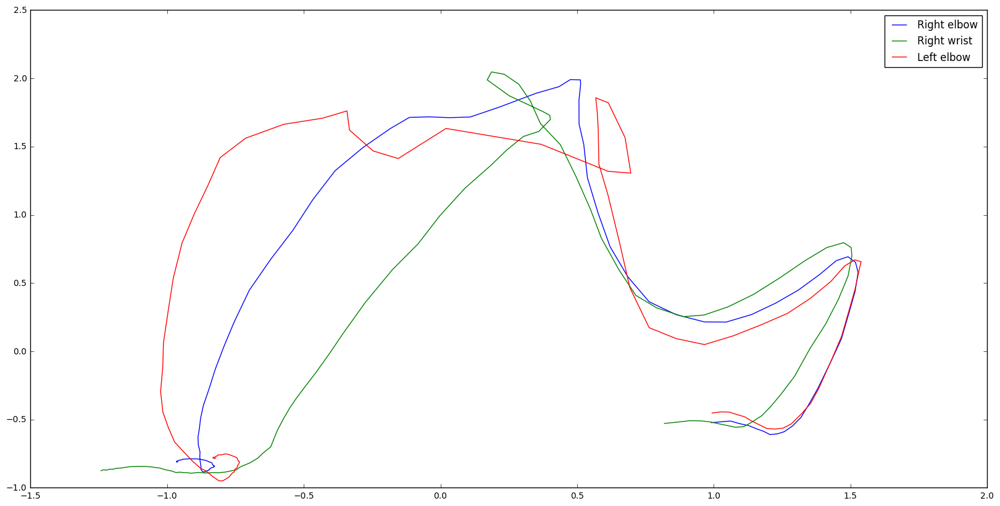

Fastball (4-seam) std_sum:  0 anzahl:  226


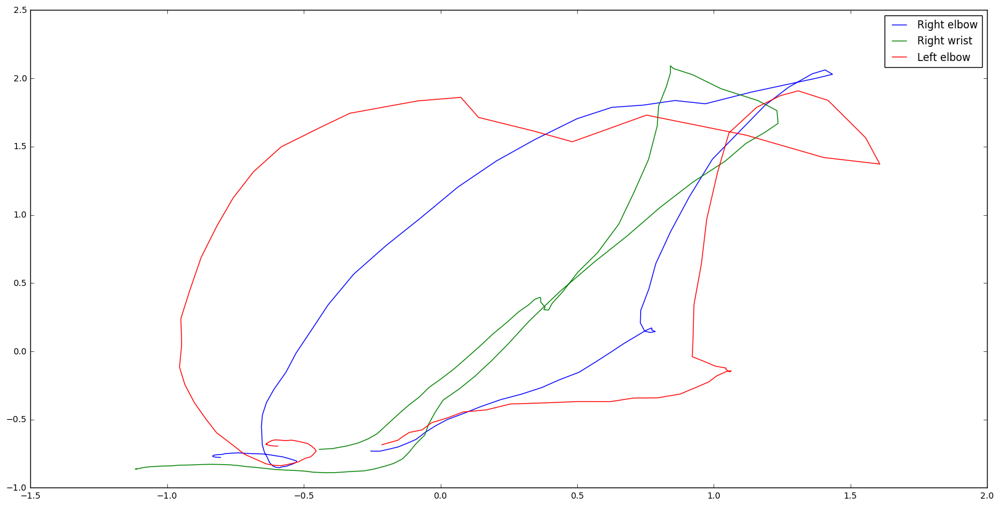

Slider std_sum:  0 anzahl:  87


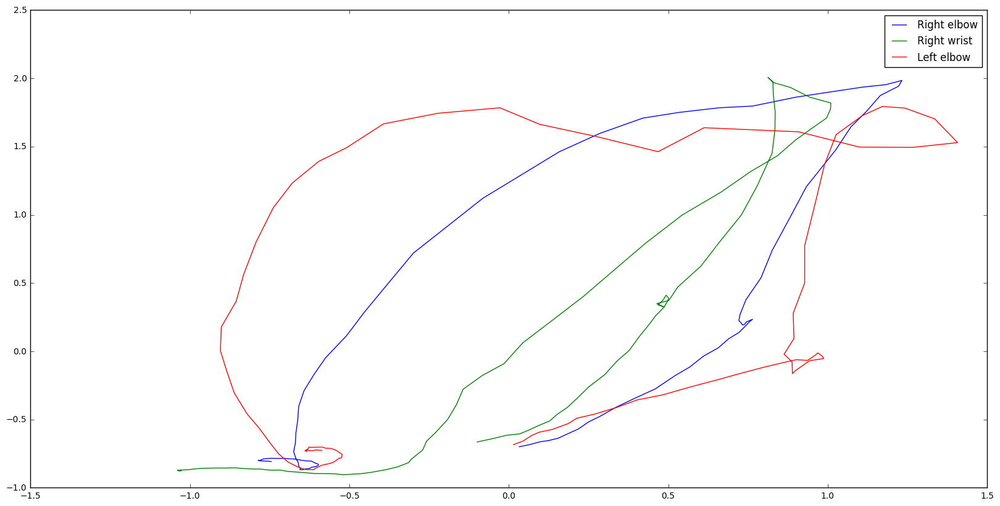

'TO SEE INTRA CLASS DIFFERENCES:\nprint("SAME AGAIN BUT ORHER EXAMPLES:")\nstds = 0\nindex = index_liste[2][0][100:100+nr_examples]\n#print(len(frame))\nif ALIGNING:\n    frame = aligned[index]\nelse:\n    frame = data[index]\n#print(unique[0], len(frame))\n#print(len(np.mean(frame[:, :, 6+i,1], axis = 0)))\nplt.figure(figsize=(20,10))\nfor i in range(NR_JOINTS):\n    x = frame[:, :, START_JOINT+i,1]\n    y = frame[:, :, START_JOINT+i,0]\n    meX = np.mean(x, axis = 0)\n    meY = np.mean(y, axis = 0)\n    stdX = np.std(x, axis = 0)\n    stdY = np.std(y, axis = 0)\n    stds+= np.mean(stdX)+np.mean(stdY)\n    plt.plot(meX, meY, label=joints[START_JOINT+i])\n    if ERRORBAR:\n        plt.errorbar(meX, meY, yerr = stdY, xerr = stdX, label=joints[6+i])\nplt.ylim(200, 60)\nplt.xlim(80,220)\nplt.legend()\nplt.show()\nprint(unique[2],"std_sum: ", stds, "anzahl: ", len(frame))\n'

In [77]:
import matplotlib.pylab as plt
joints=["Right shoulder", "Left shoulder", "Right elbow", "Right wrist","Left elbow", "Left wrist",
        "Right hip", "Right knee", "Right ankle", "Left hip", "Left knee", "Left ankle", "Neck ", 
        "Right eye", "Right ear","Left eye", "Left ear"]
from tools import Tools
aligned = Tools.align_frames(data, pre.get_release_frame(60, 120), 60, 40)
aligned = Tools.normalize(aligned)
ALIGNING = True
ERRORBAR = False
START_JOINT = 0
NR_JOINTS = 3
nr_examples = len(data) # 100

stds = 0
index = np.random.choice(data.shape[0], nr_examples)
if ALIGNING:
    frame = aligned[index]
else:
    frame = data[index]
#print(labels[10])
#print(len(np.mean(frame[:, :, 6+i,1], axis = 0)))
print("All pitch types ", "std_sum: ", stds, "number: ", len(frame))
plt.figure(figsize=(20,10))
for i in range(NR_JOINTS):
    x = frame[:, :, START_JOINT+i,1]
    y = frame[:, :, START_JOINT+i,0]
    meX = np.mean(x, axis = 0)
    meY = np.mean(y, axis = 0)
    stdX = np.std(x, axis = 0)
    stdY = np.std(y, axis = 0)
    stds+= np.mean(stdX)+np.mean(stdY)
    plt.plot(meX, meY, label=joints[START_JOINT+i])
    if ERRORBAR:
        plt.errorbar(meX, meY, yerr = stdY, xerr = stdX, label=joints[START_JOINT+i])
#plt.ylim(200, 60)
#plt.xlim(80,220)
plt.legend()
plt.show()

meansX = np.zeros((len(index_liste), NR_JOINTS))
meansY = np.zeros((len(index_liste), NR_JOINTS))
errorX = np.zeros((len(index_liste), NR_JOINTS))
errorY = np.zeros((len(index_liste), NR_JOINTS))

for j in range(len(index_liste)):
    stds = 0
    nr_examples = len(index_liste[j][0])    #100
    index = index_liste[j][0][:nr_examples]
    #print(indizes)
    #print(len(frame))
    if ALIGNING:
        frame = aligned[index]
    else:
        frame = data[index]
    print(unique[j],"std_sum: ", stds, "anzahl: ", len(frame))
    #print(unique[0], len(frame))
    #print(len(np.mean(frame[:, :, 6+i,1], axis = 0)))
    plt.figure(figsize=(20,10))
    for i in range(NR_JOINTS):
        
        x = frame[:, :, START_JOINT+i,1]
        y = frame[:, :, START_JOINT+i,0]
        meX = np.mean(x, axis = 0)
        meY = np.mean(y, axis = 0)
        error = []
        #print(error)
        stdX = np.std(x, axis = 0)
        stdY = np.std(y, axis = 0)
        stds+= np.mean(stdX)+np.mean(stdY)
        plt.plot(meX, meY, label=joints[2+i])
        if ERRORBAR:
            plt.errorbar(meX, meY, yerr = stdY, xerr = stdX, label=joints[START_JOINT+i])
    # plt.ylim(200, 60)
    # plt.xlim(80,220)
    plt.legend()
    plt.show()
    

"""TO SEE INTRA CLASS DIFFERENCES:
print("SAME AGAIN BUT ORHER EXAMPLES:")
stds = 0
index = index_liste[2][0][100:100+nr_examples]
#print(len(frame))
if ALIGNING:
    frame = aligned[index]
else:
    frame = data[index]
#print(unique[0], len(frame))
#print(len(np.mean(frame[:, :, 6+i,1], axis = 0)))
plt.figure(figsize=(20,10))
for i in range(NR_JOINTS):
    x = frame[:, :, START_JOINT+i,1]
    y = frame[:, :, START_JOINT+i,0]
    meX = np.mean(x, axis = 0)
    meY = np.mean(y, axis = 0)
    stdX = np.std(x, axis = 0)
    stdY = np.std(y, axis = 0)
    stds+= np.mean(stdX)+np.mean(stdY)
    plt.plot(meX, meY, label=joints[START_JOINT+i])
    if ERRORBAR:
        plt.errorbar(meX, meY, yerr = stdY, xerr = stdX, label=joints[6+i])
plt.ylim(200, 60)
plt.xlim(80,220)
plt.legend()
plt.show()
print(unique[2],"std_sum: ", stds, "anzahl: ", len(frame))
"""

## Plot all examples

-----------------------------------------------------------------------------
JOINT:  Right shoulder
Changeup


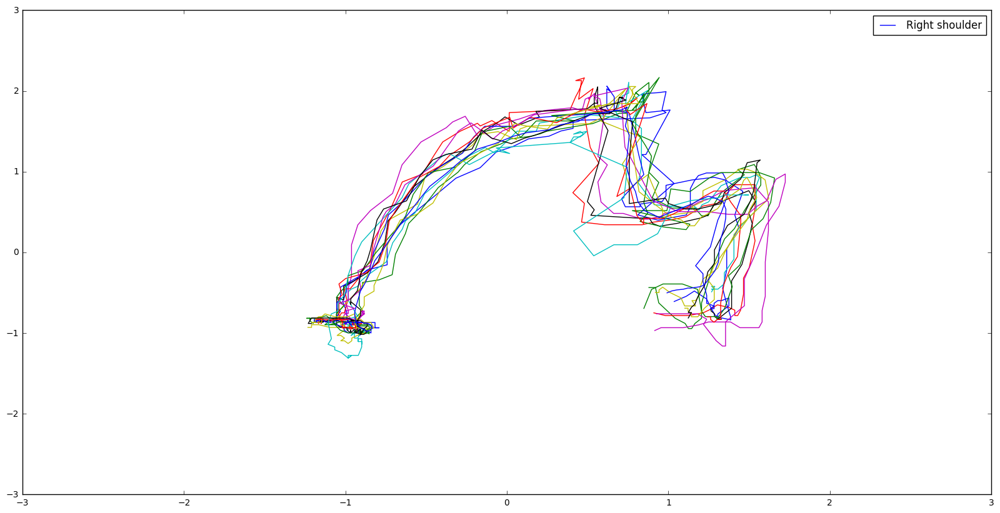

Curveball


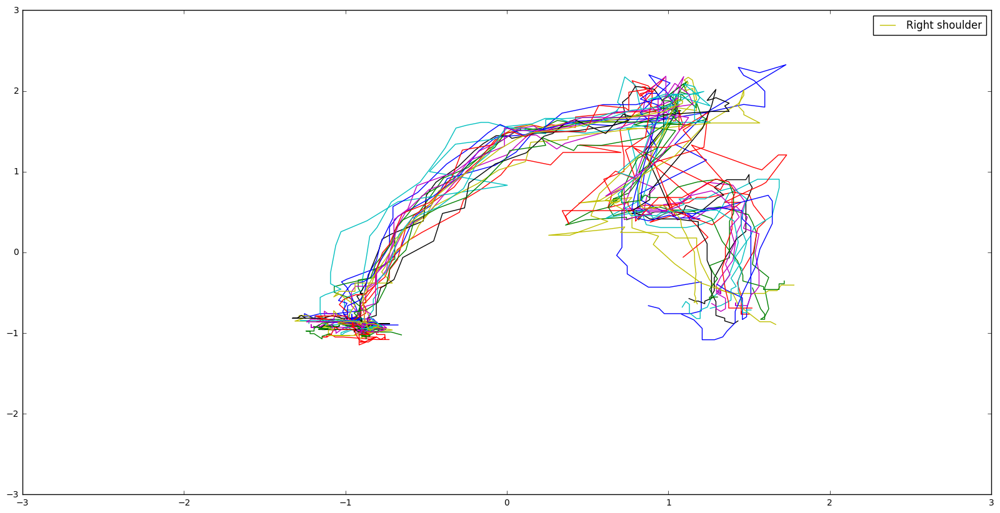

Fastball (2-seam)


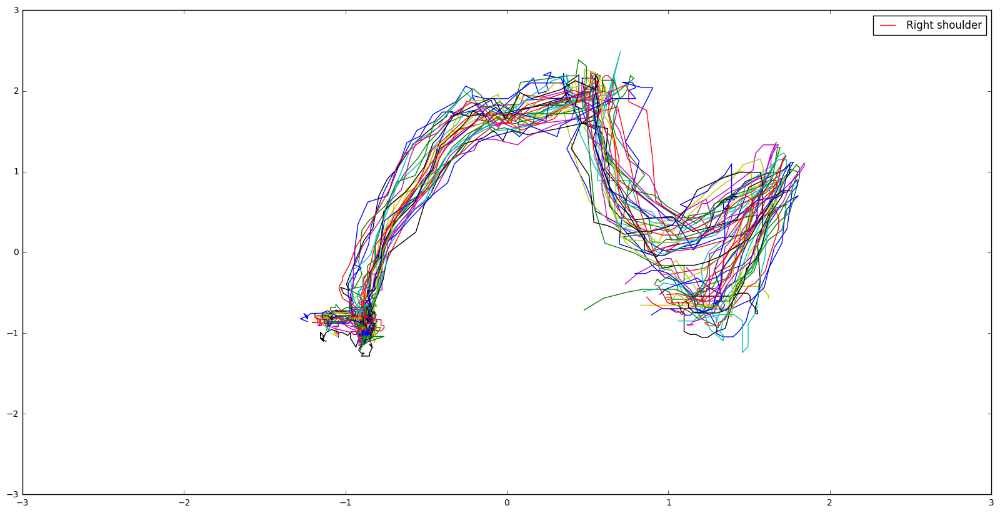

Fastball (4-seam)


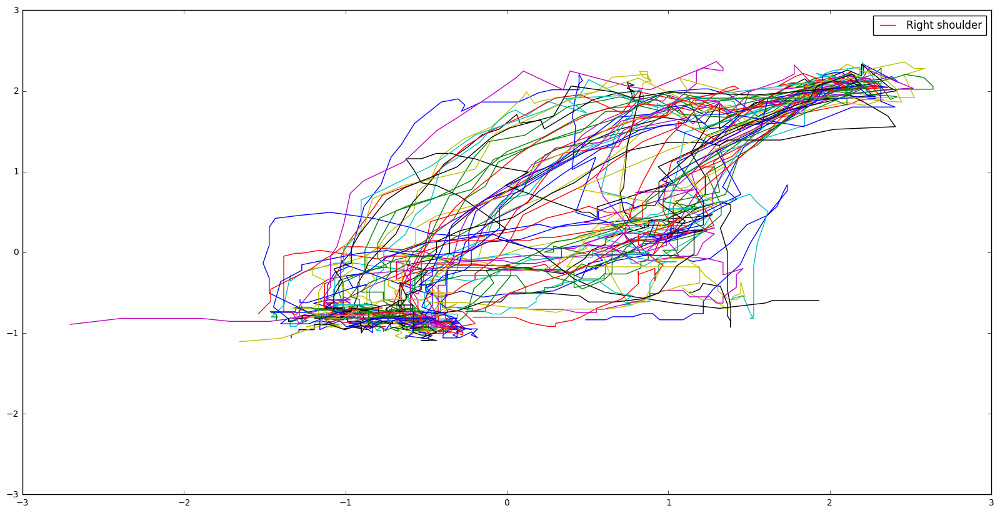

Slider


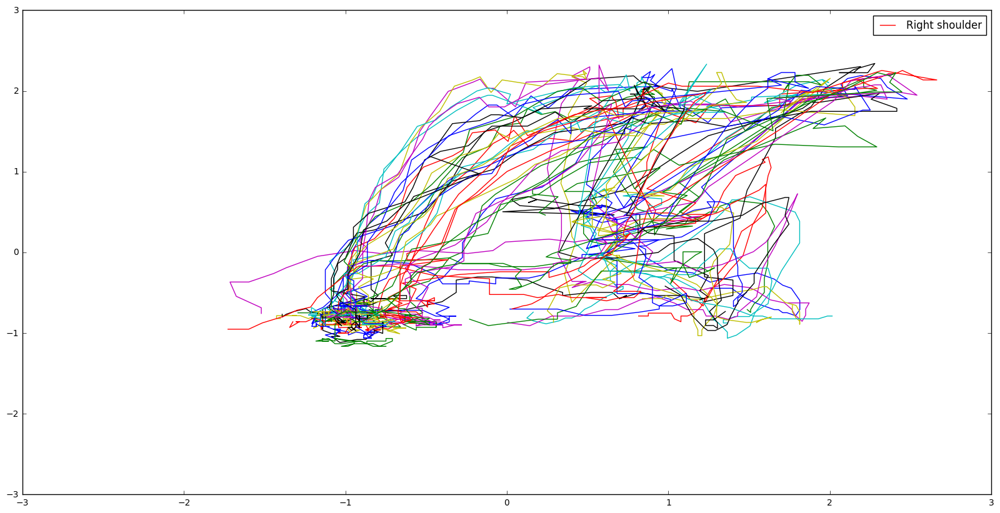

-----------------------------------------------------------------------------
JOINT:  Left shoulder
Changeup


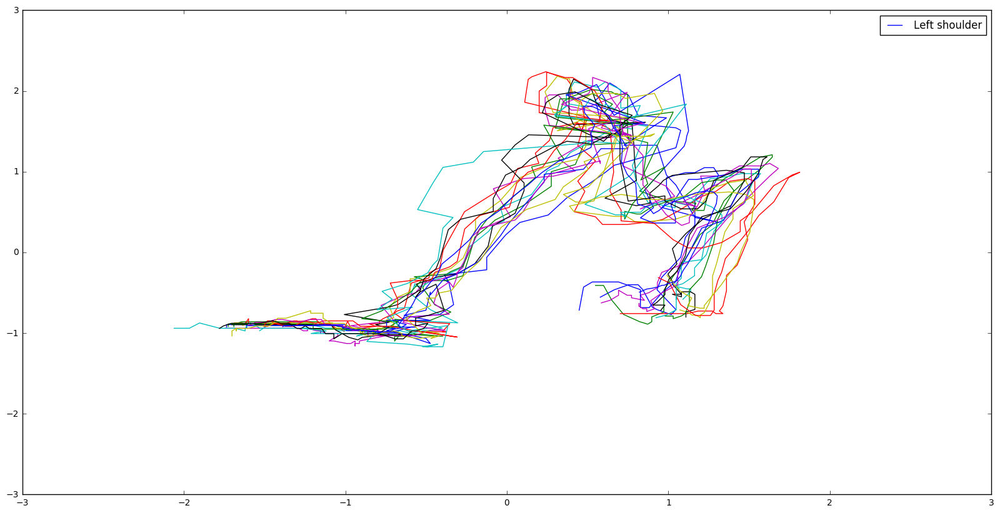

Curveball


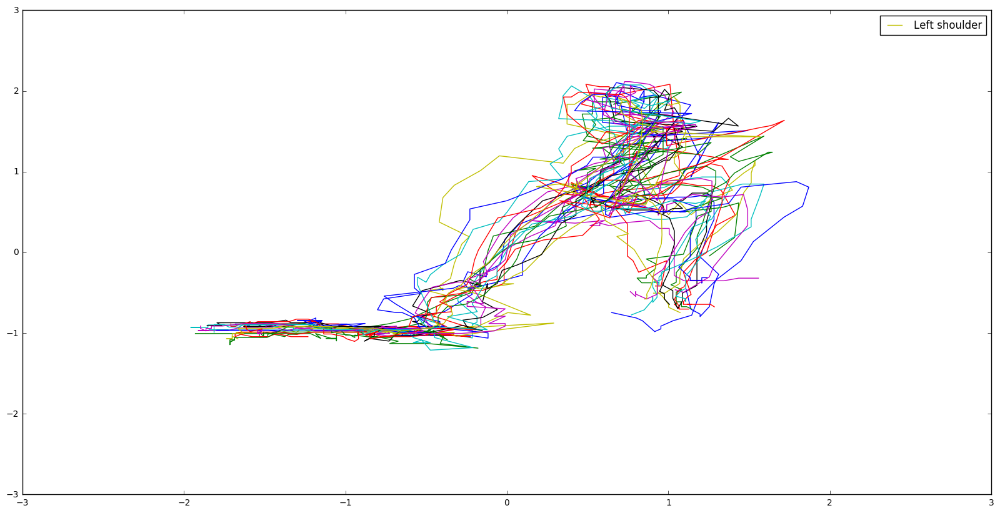

Fastball (2-seam)


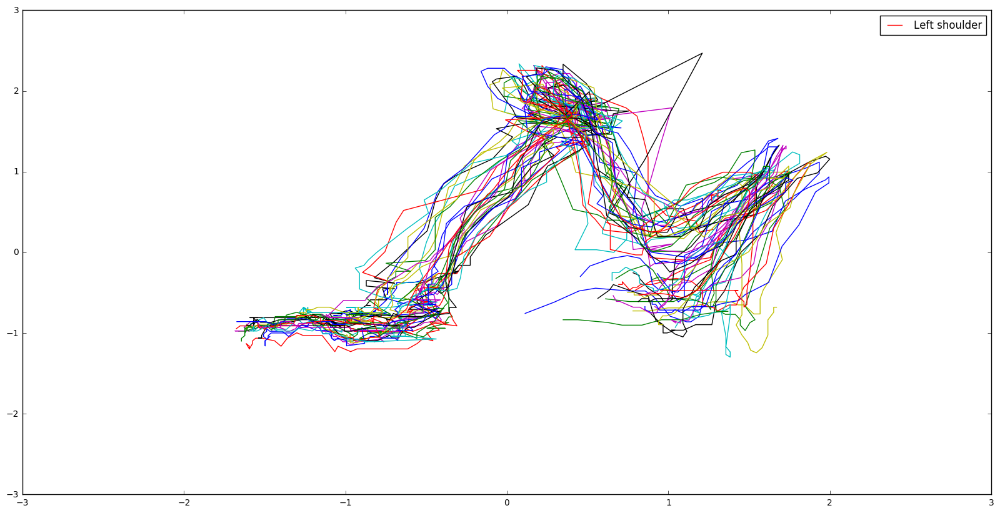

Fastball (4-seam)


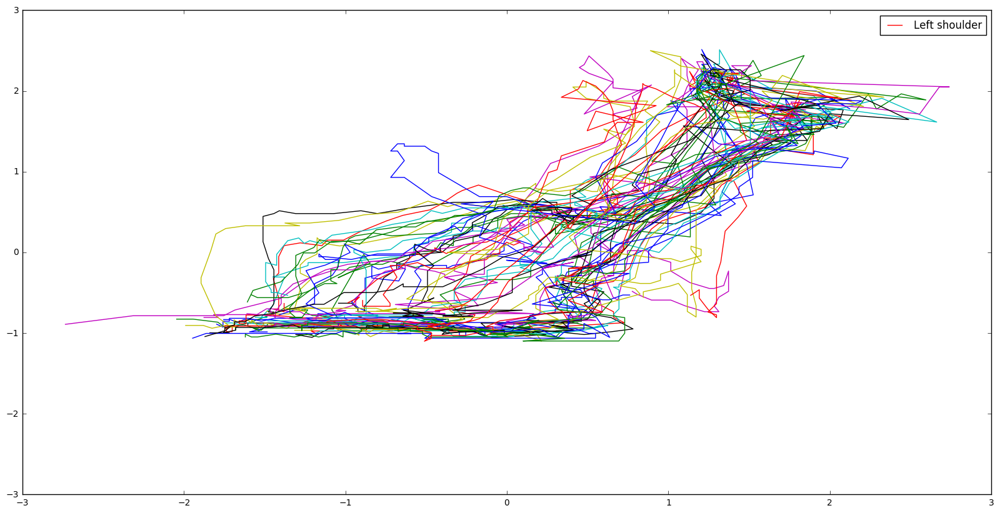

Slider


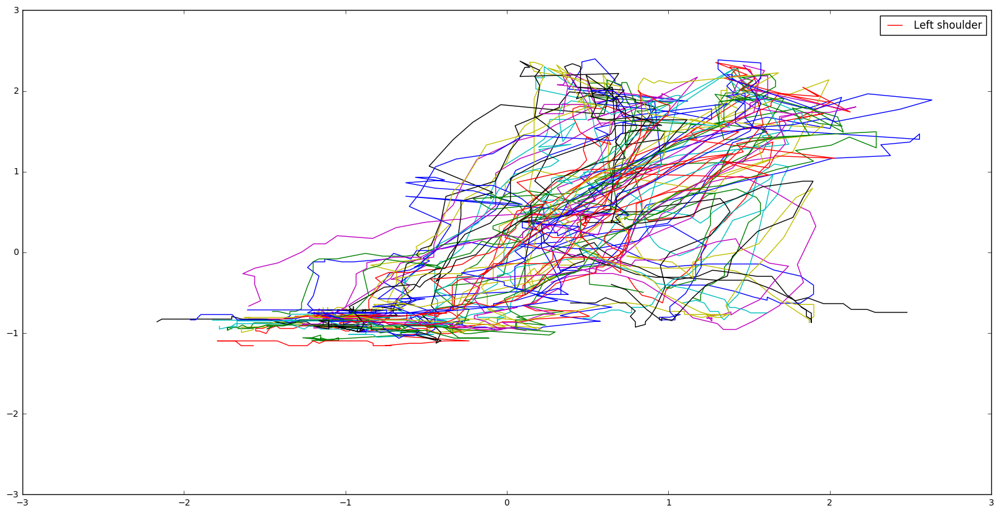

-----------------------------------------------------------------------------
JOINT:  Right elbow
Changeup


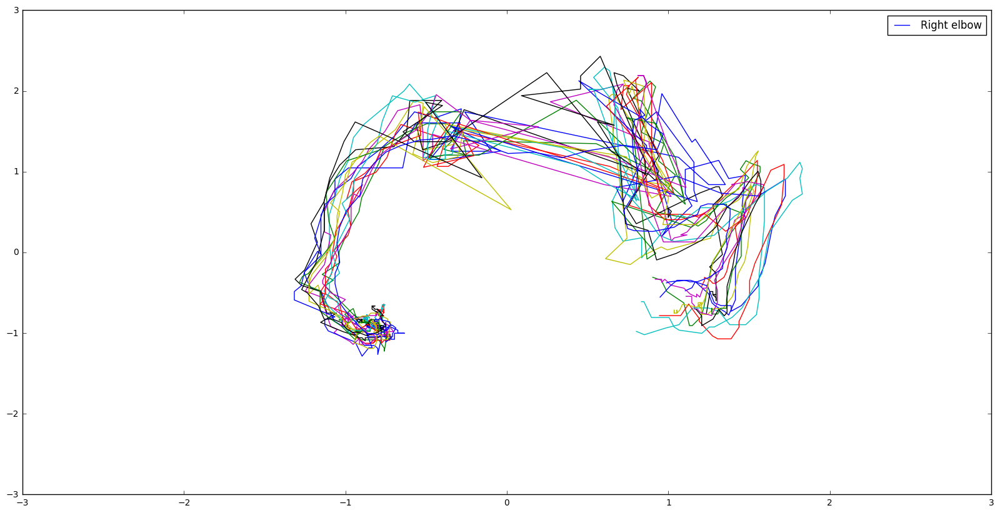

Curveball


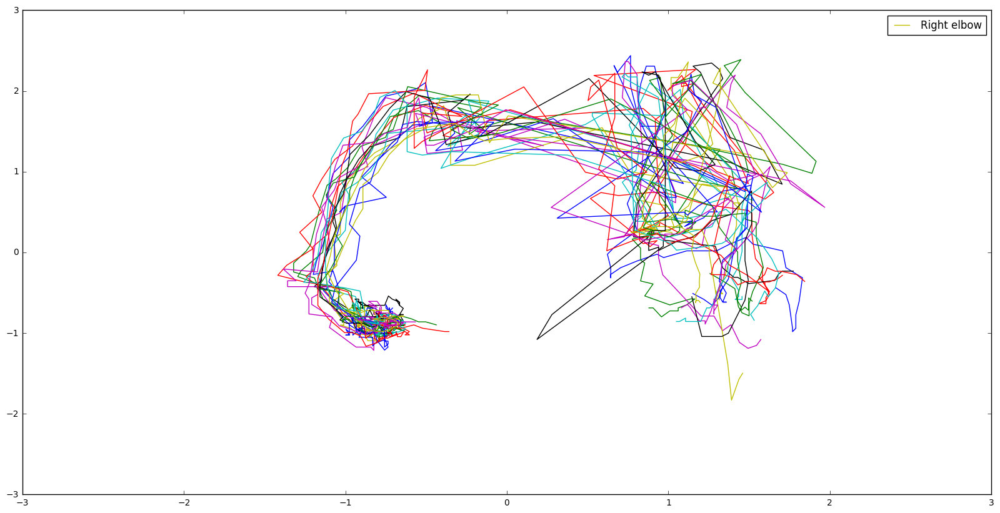

Fastball (2-seam)


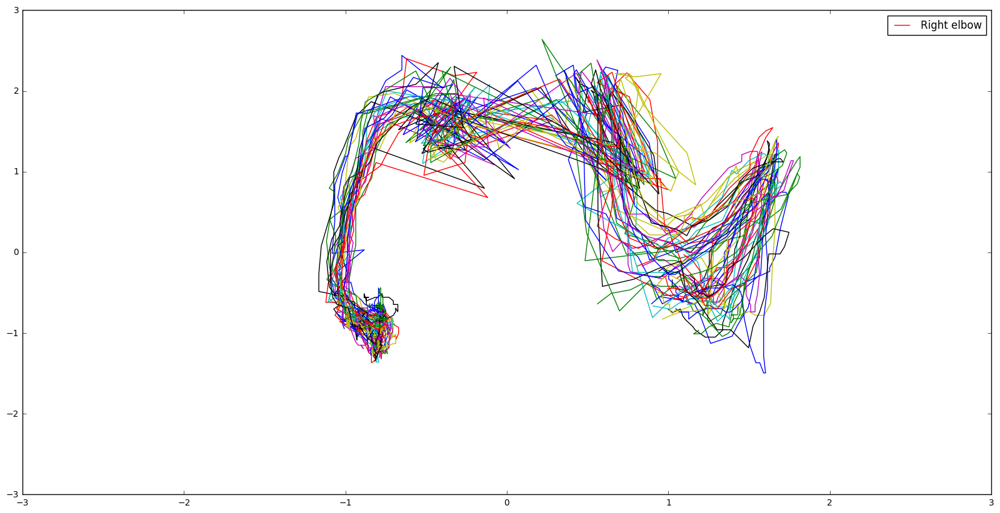

Fastball (4-seam)


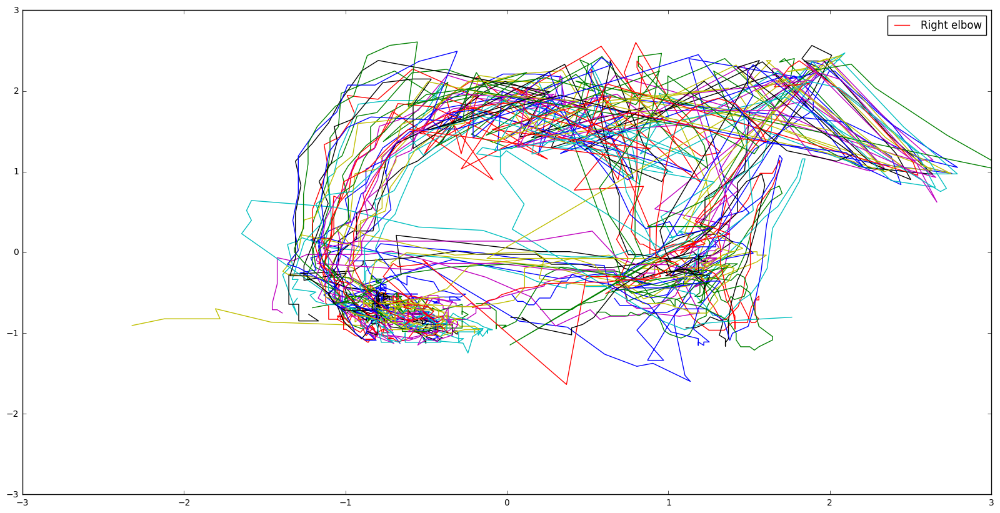

Slider


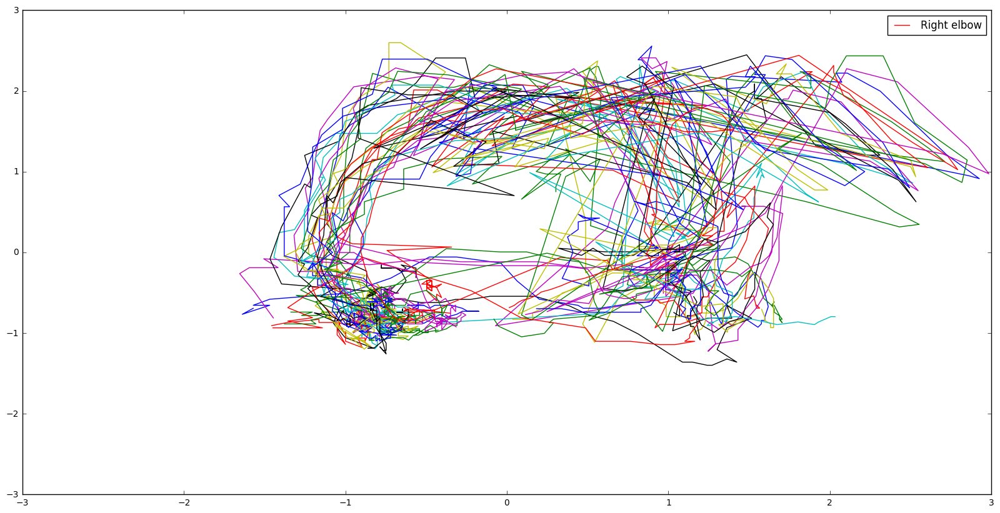

-----------------------------------------------------------------------------
JOINT:  Right wrist
Changeup


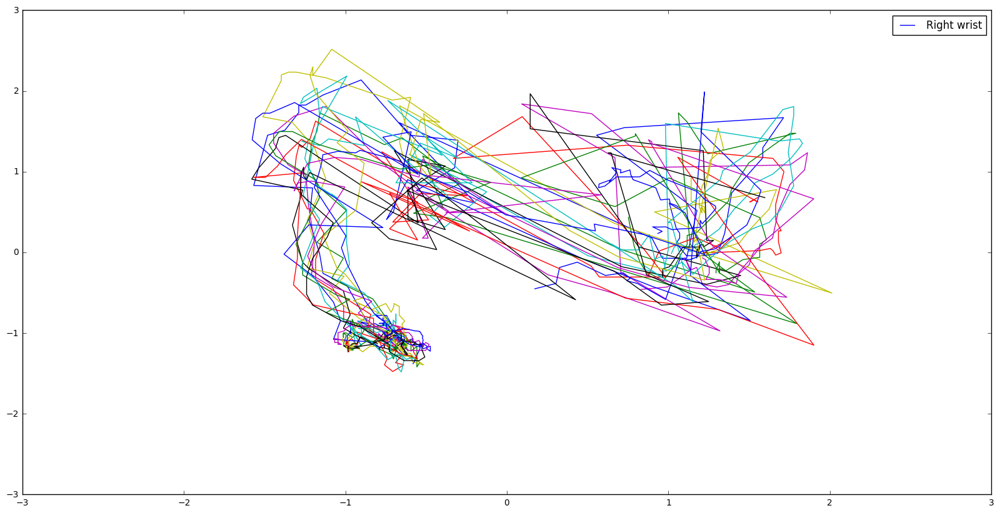

Curveball


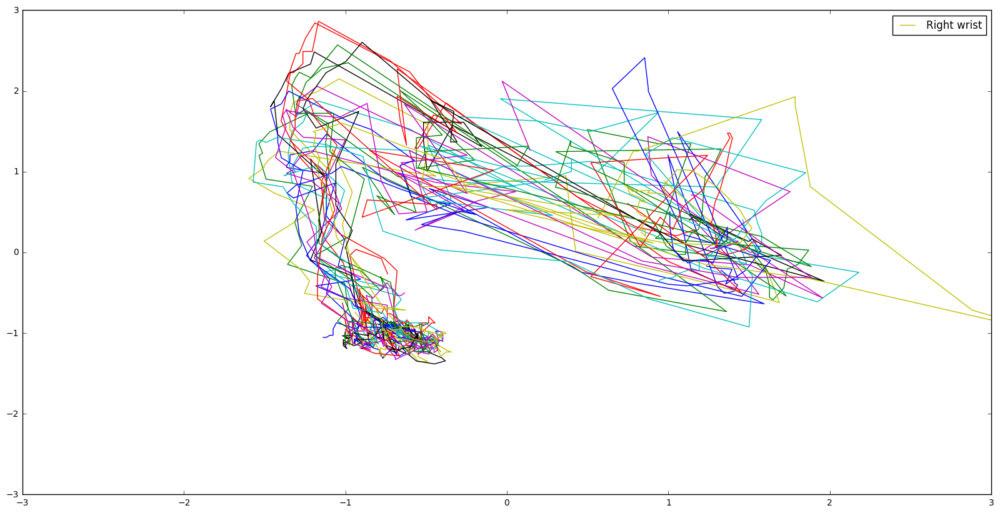

Fastball (2-seam)


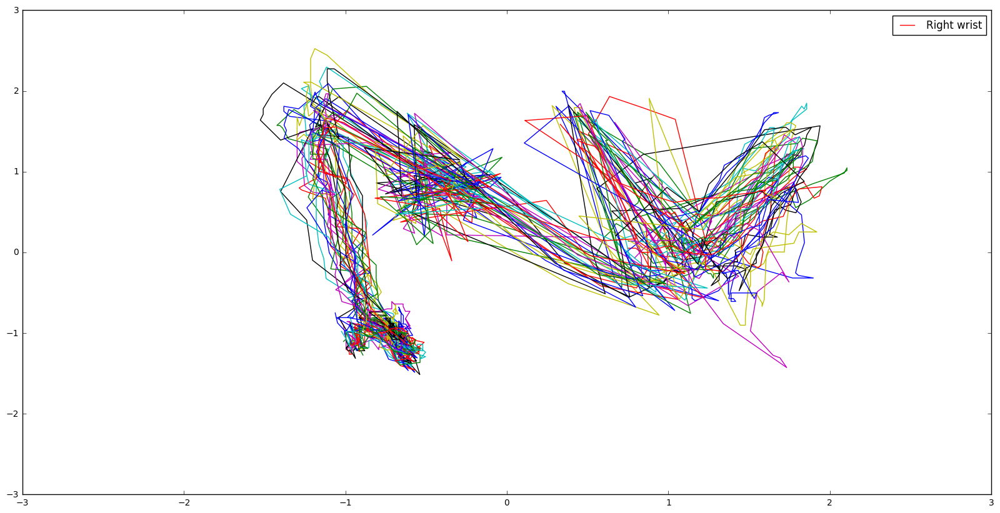

Fastball (4-seam)


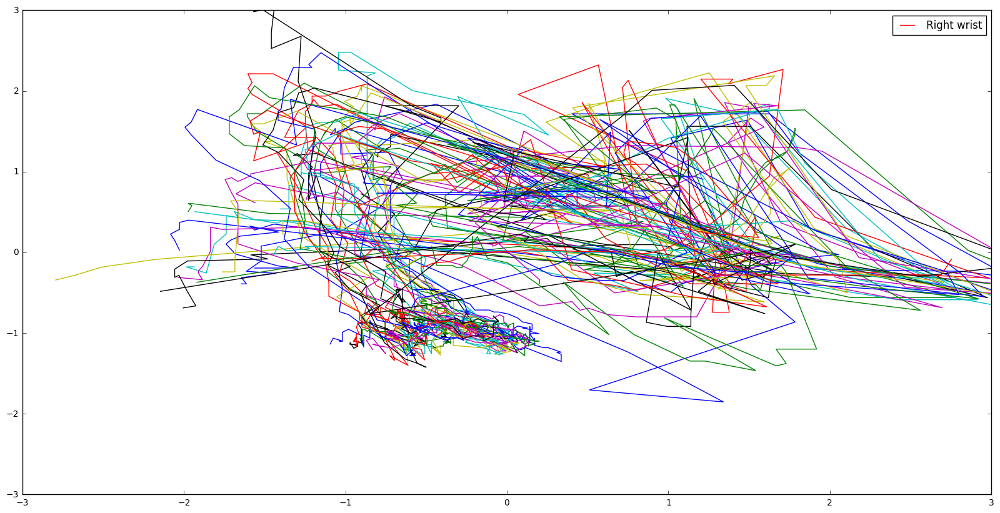

Slider


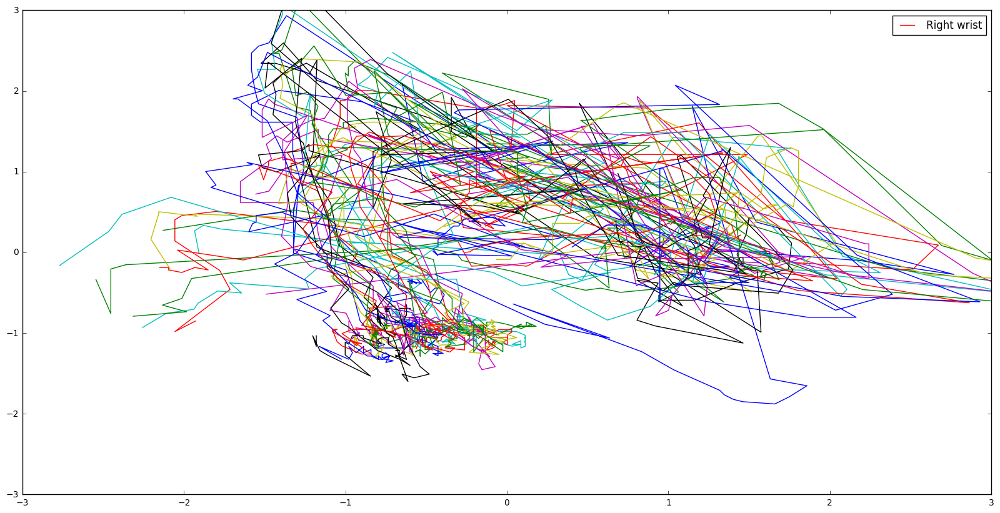

-----------------------------------------------------------------------------
JOINT:  Left elbow
Changeup


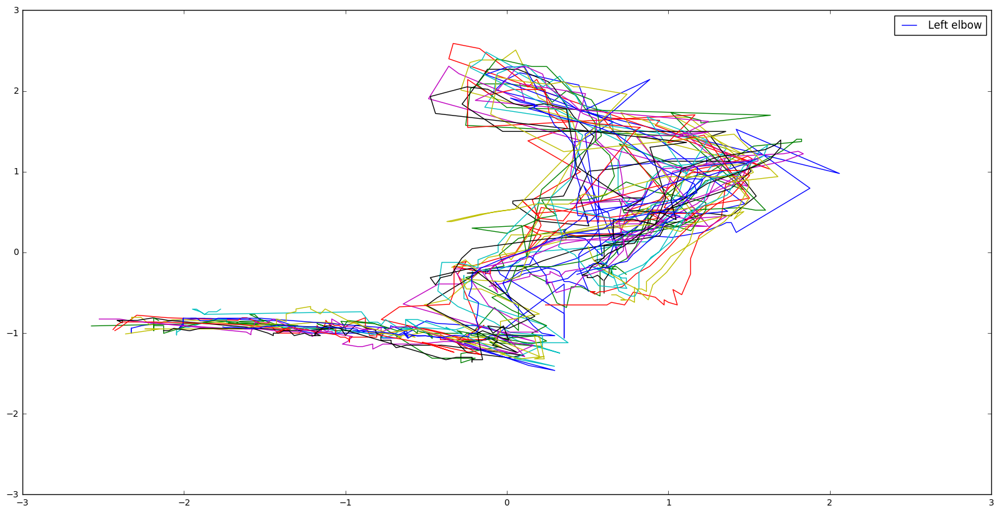

Curveball


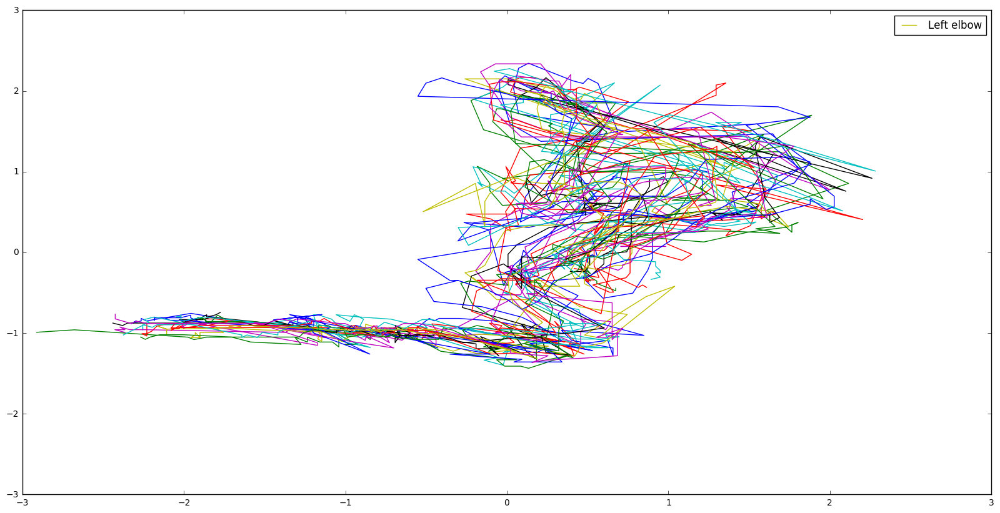

Fastball (2-seam)


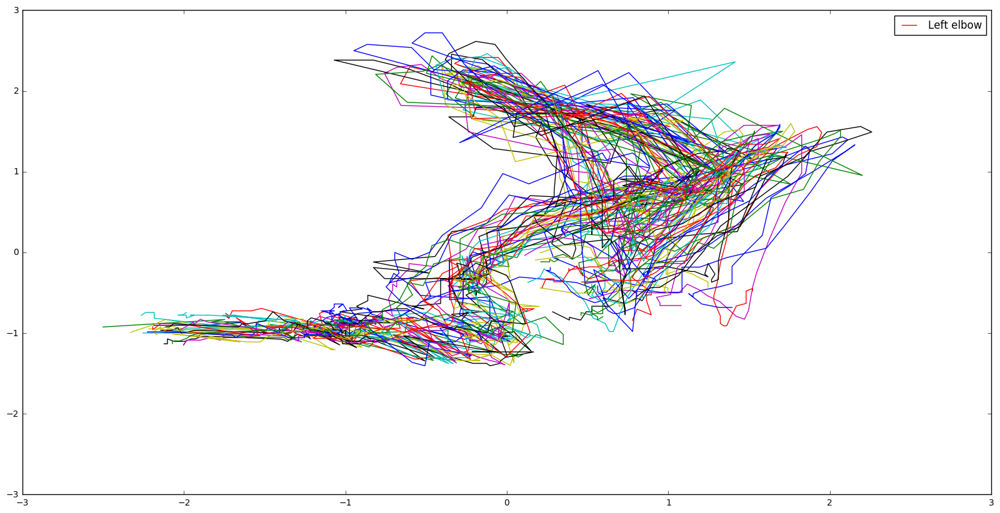

Fastball (4-seam)


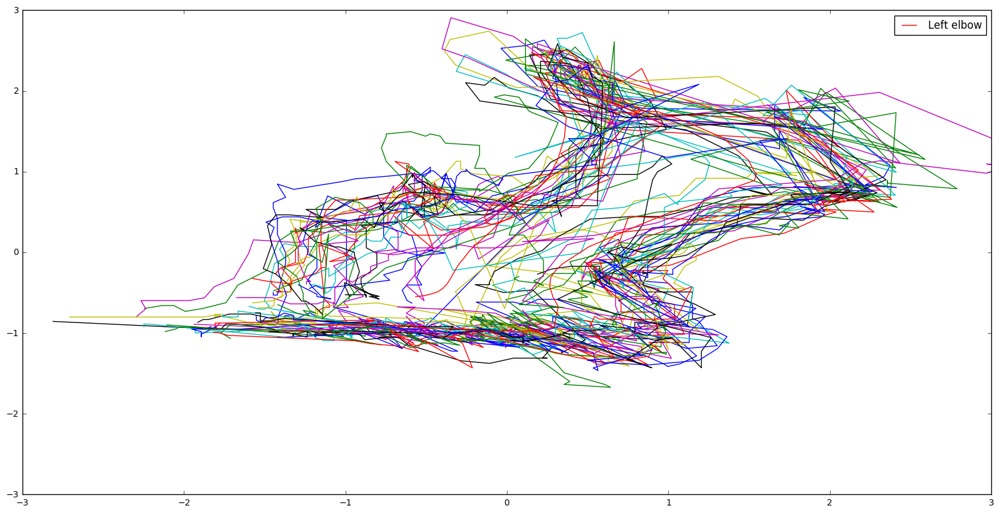

Slider


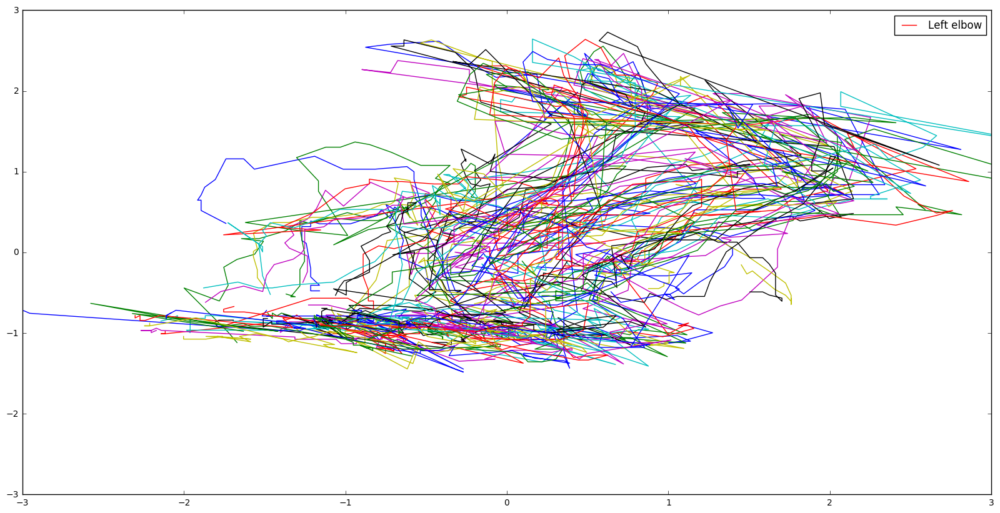

-----------------------------------------------------------------------------
JOINT:  Left wrist
Changeup


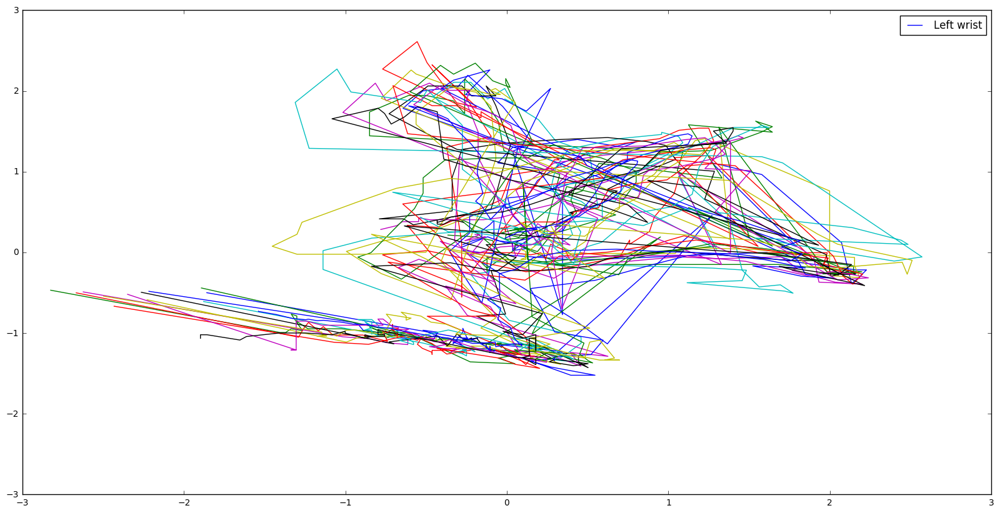

Curveball


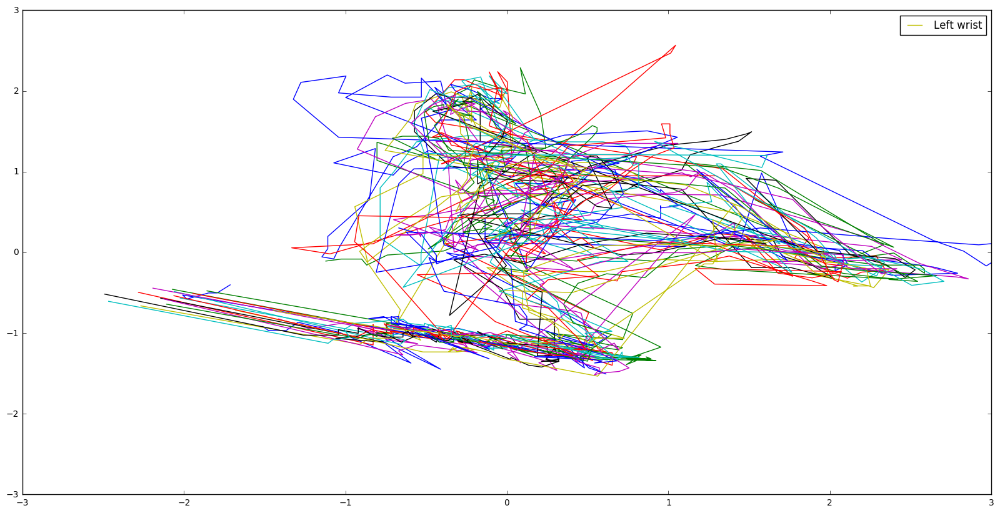

Fastball (2-seam)


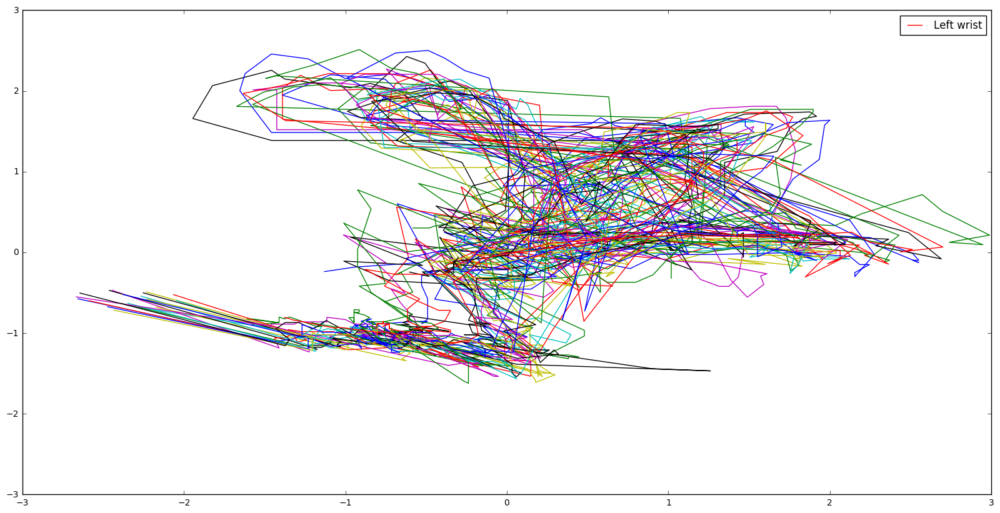

Fastball (4-seam)


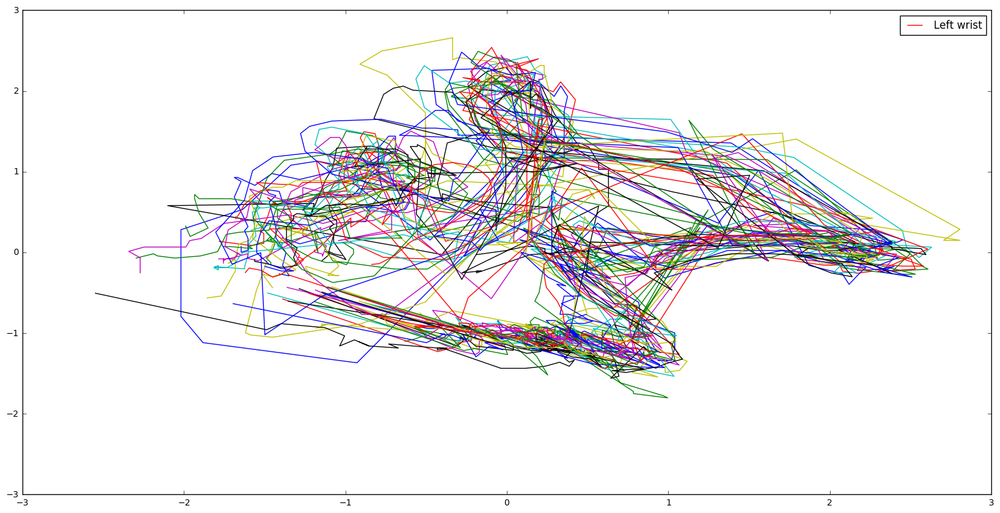

Slider


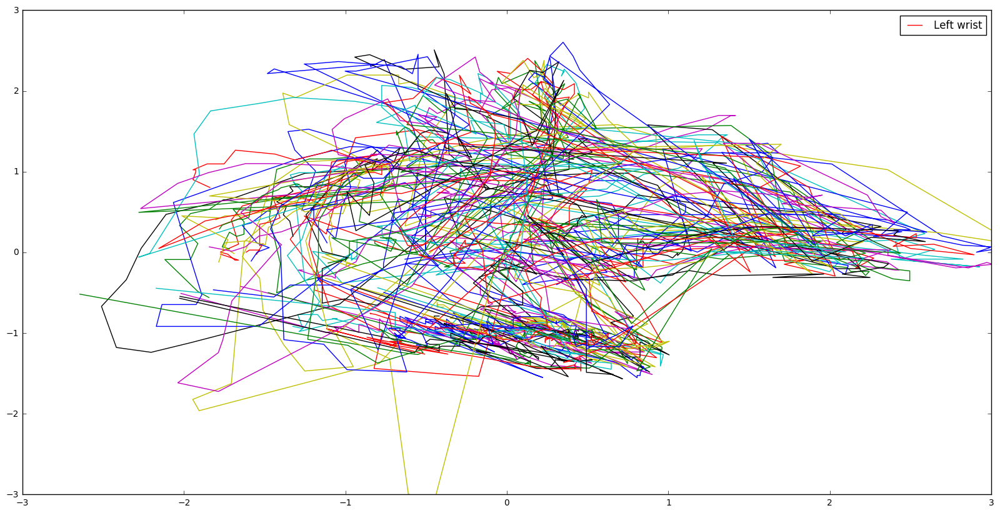

-----------------------------------------------------------------------------
JOINT:  Right hip
Changeup


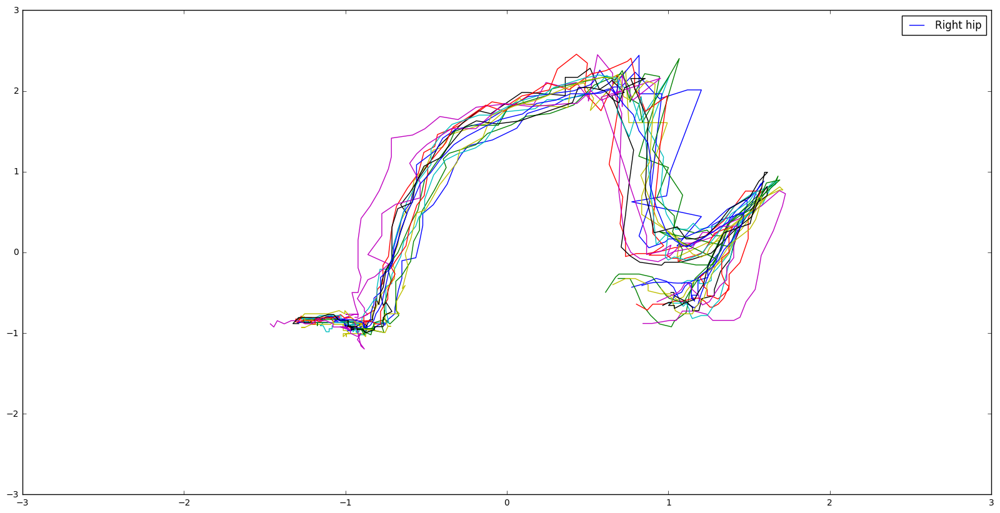

Curveball


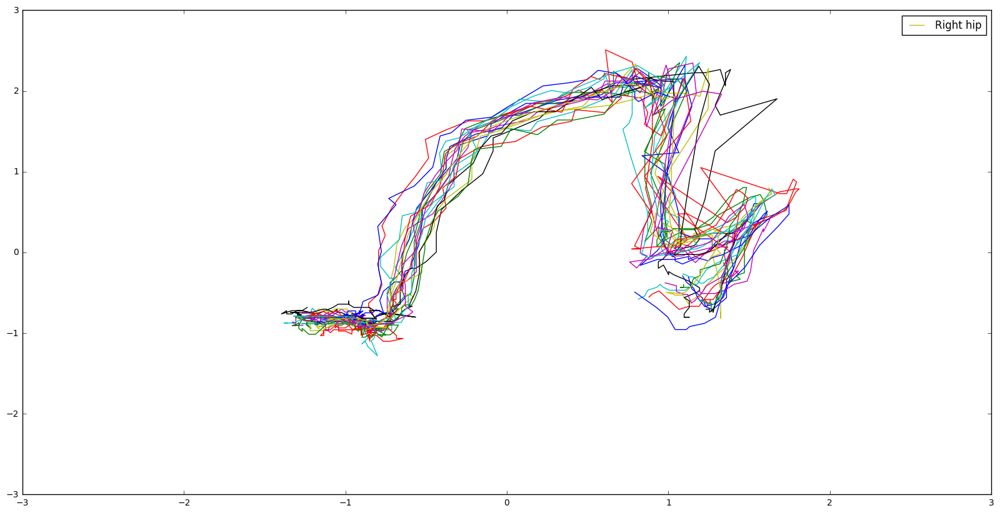

Fastball (2-seam)


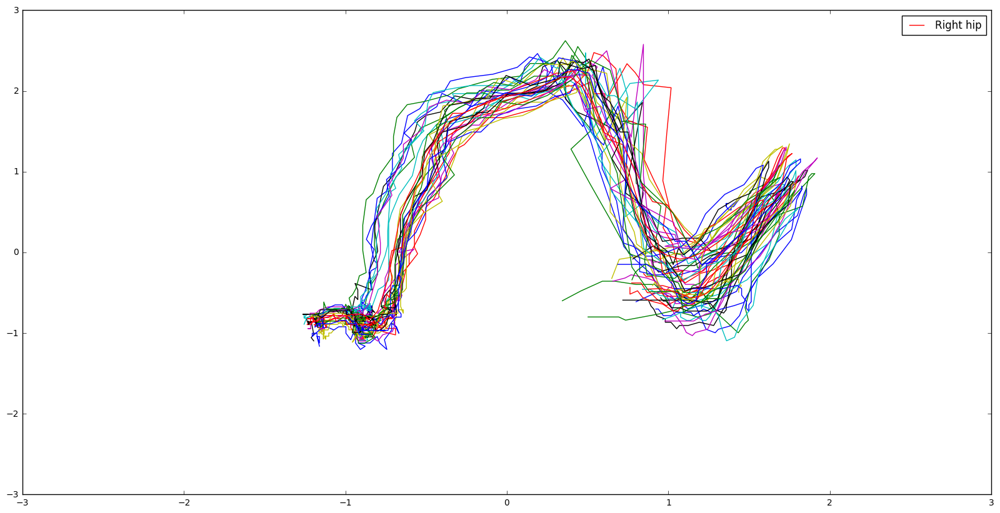

Fastball (4-seam)


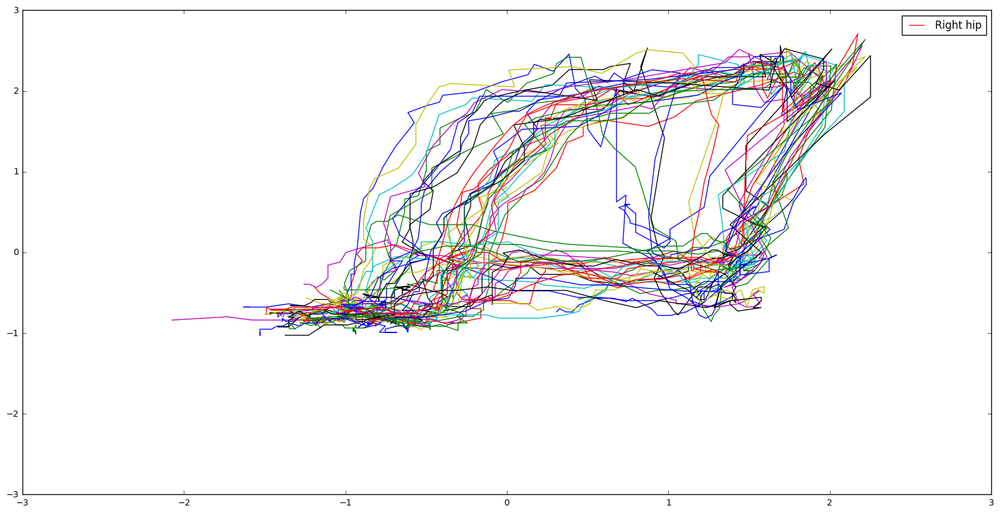

Slider


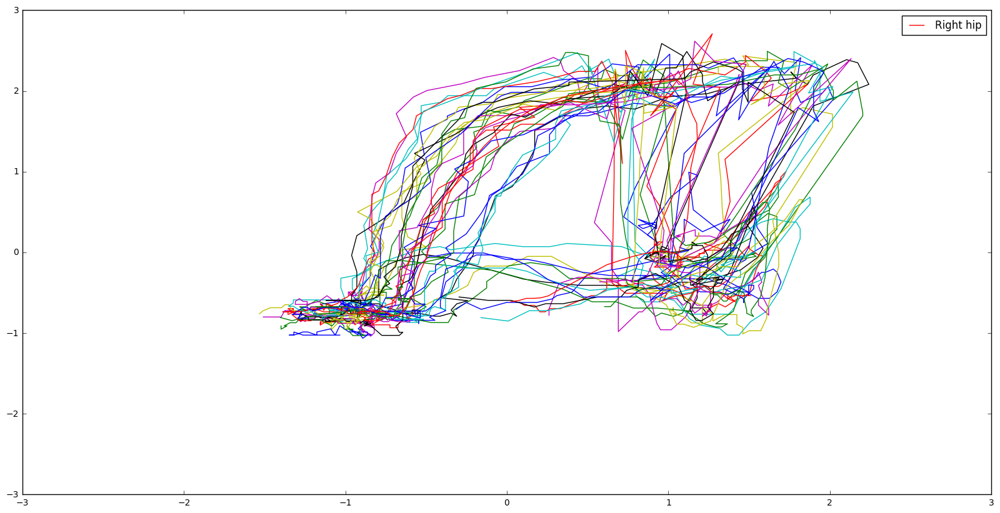

-----------------------------------------------------------------------------
JOINT:  Right knee
Changeup


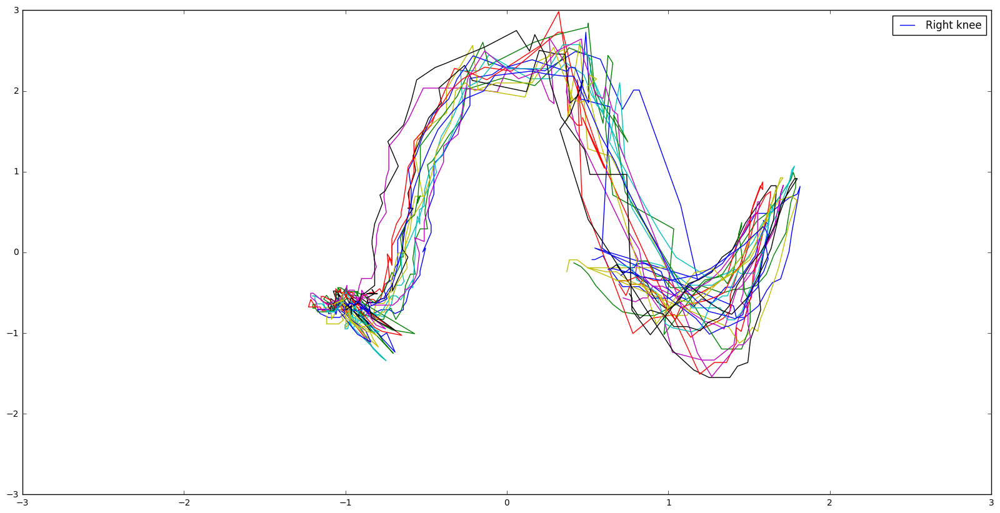

Curveball


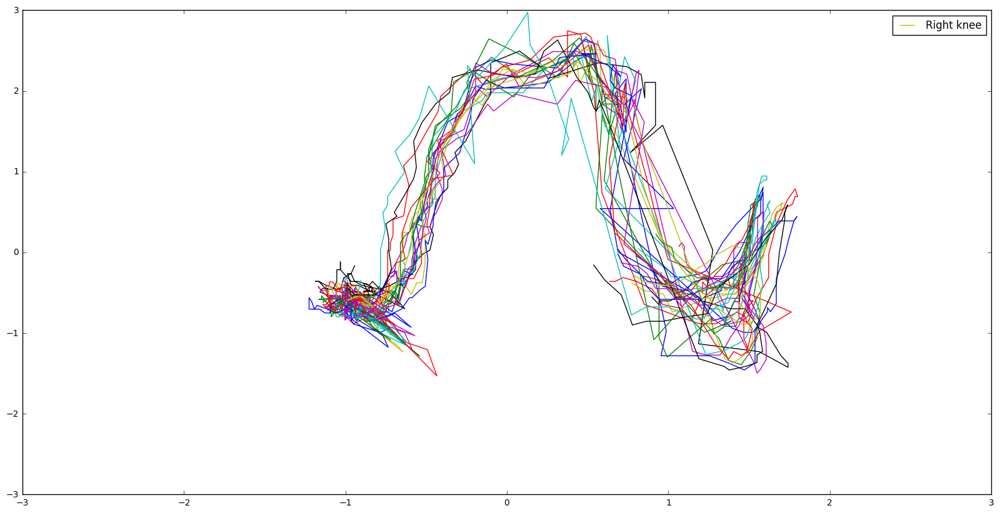

Fastball (2-seam)


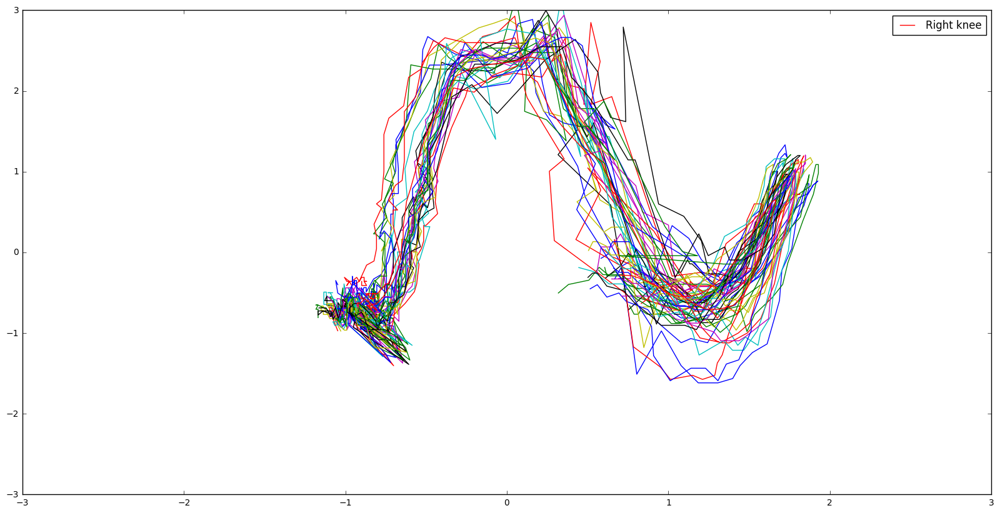

Fastball (4-seam)


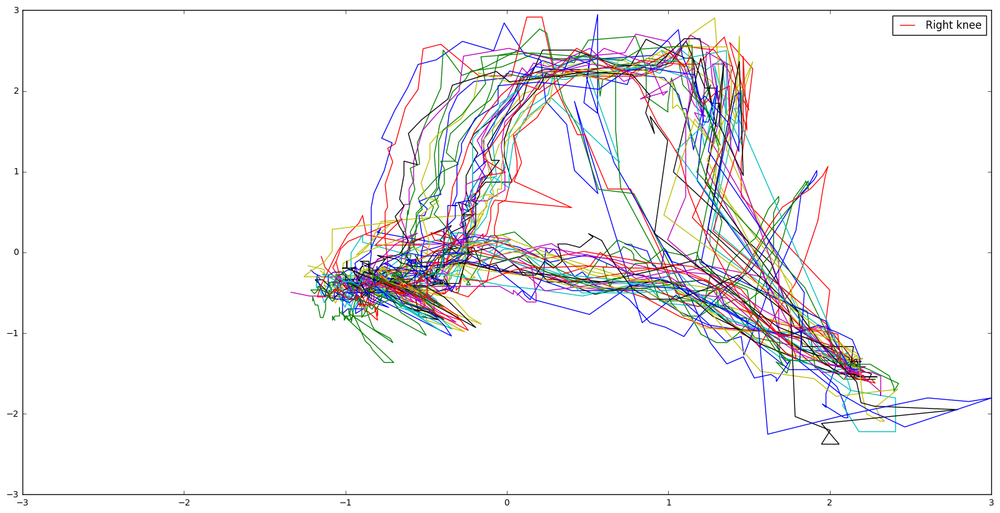

Slider


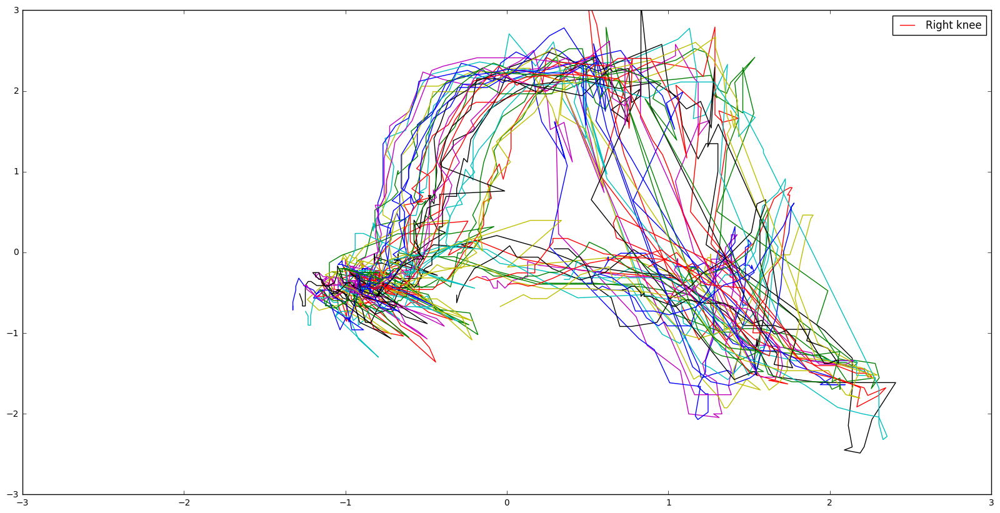

-----------------------------------------------------------------------------
JOINT:  Right ankle
Changeup


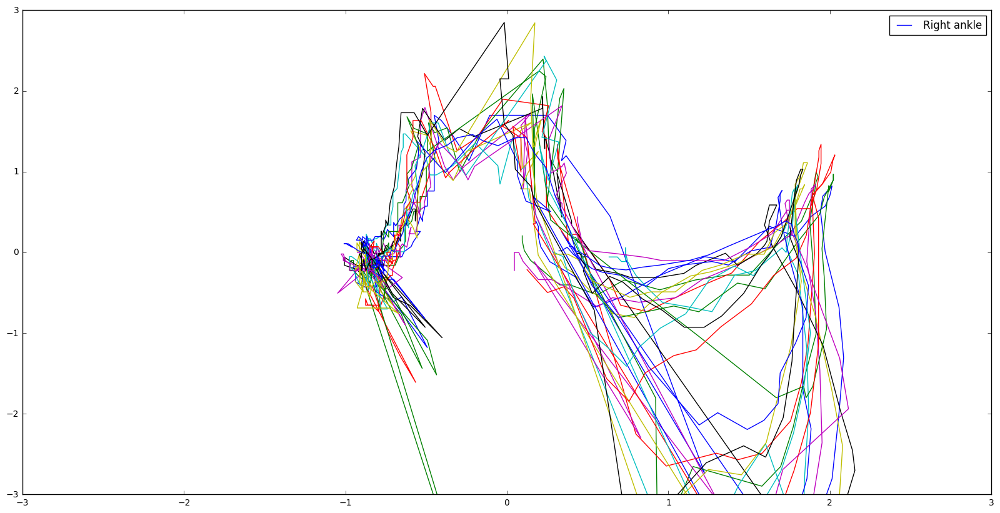

Curveball


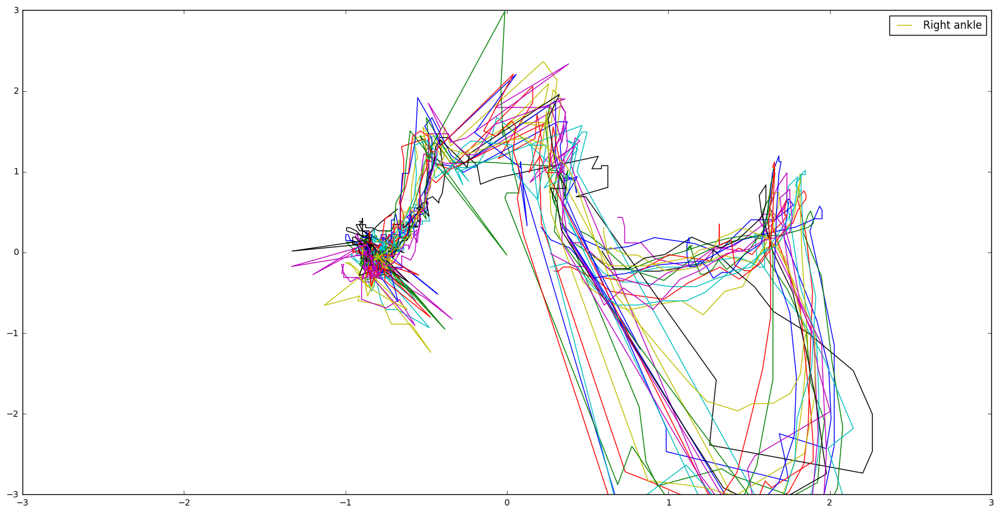

Fastball (2-seam)


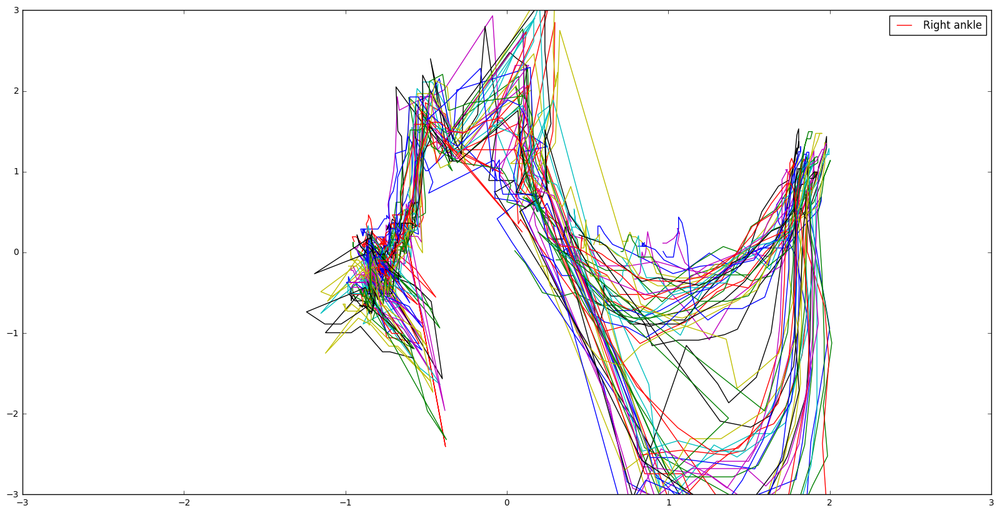

Fastball (4-seam)


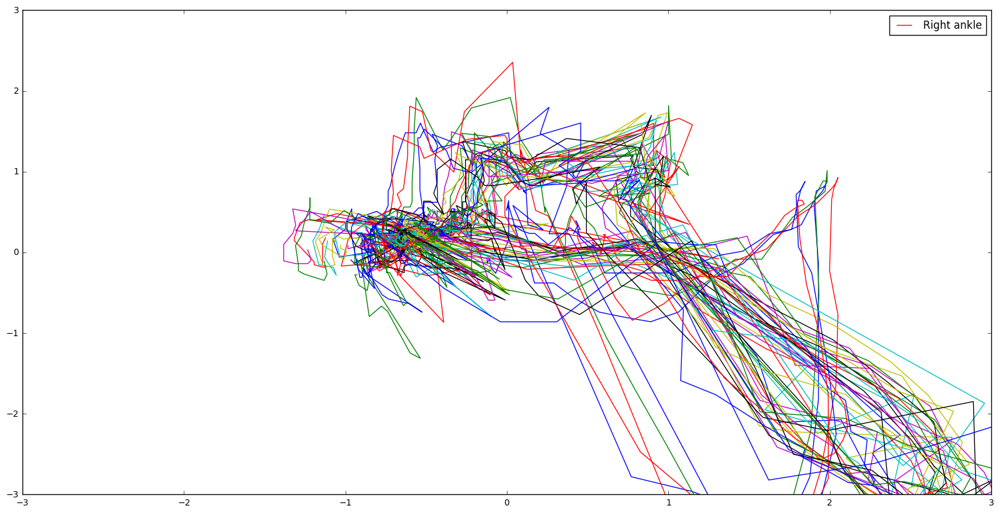

Slider


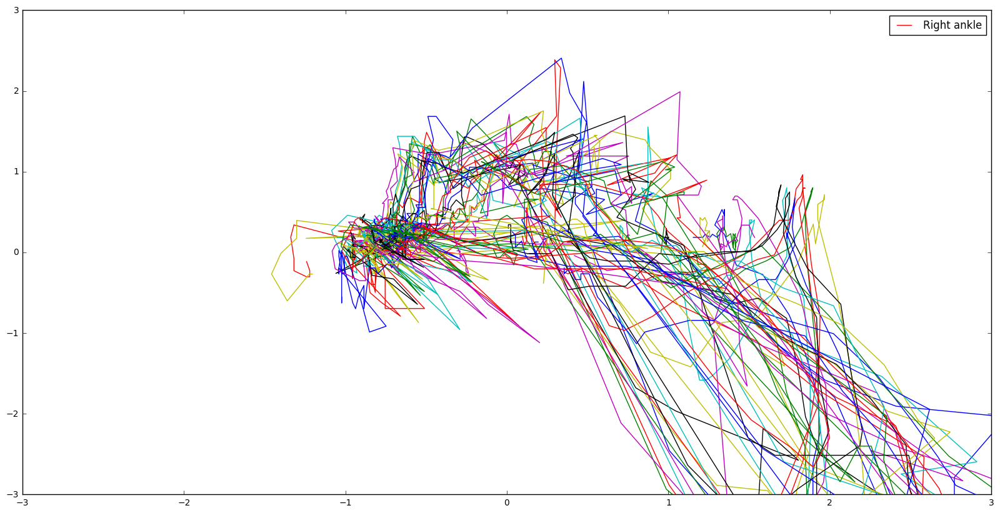

-----------------------------------------------------------------------------
JOINT:  Left hip
Changeup


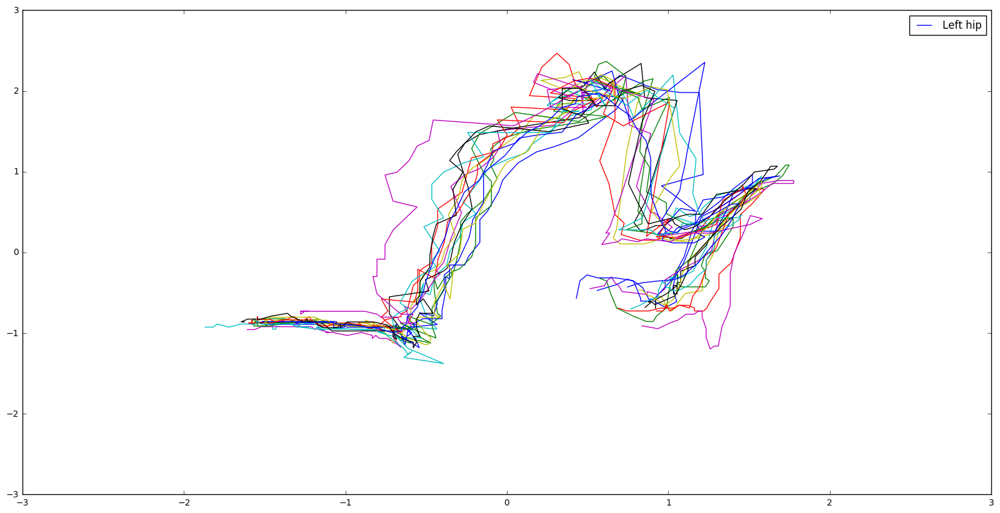

Curveball


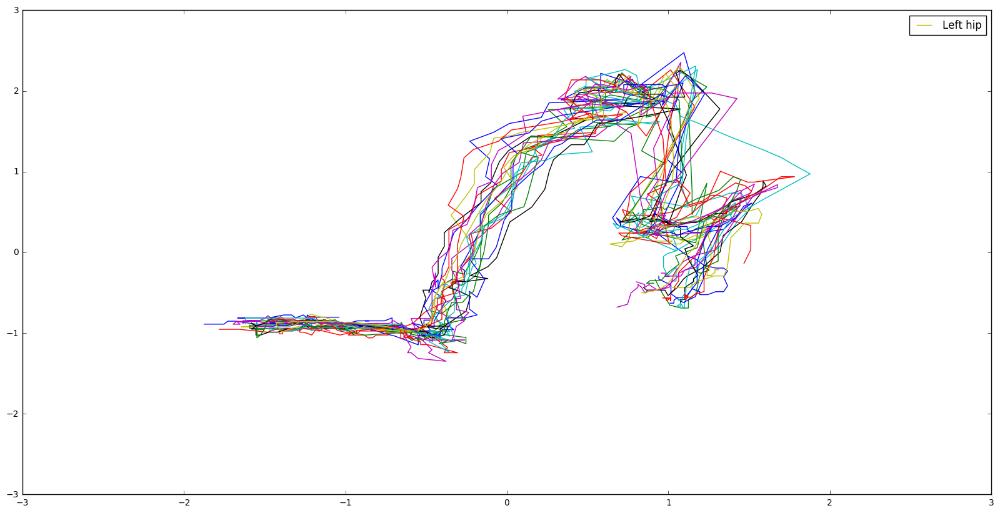

Fastball (2-seam)


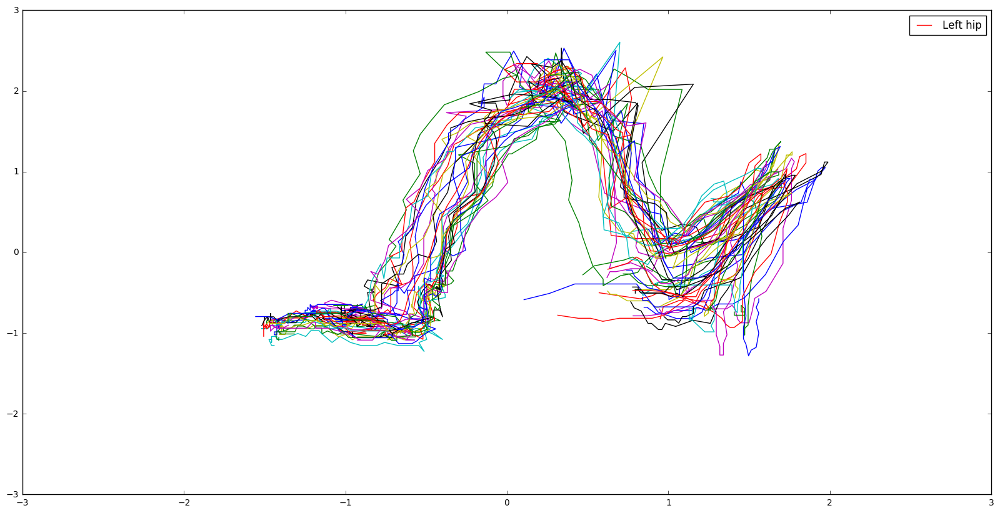

Fastball (4-seam)


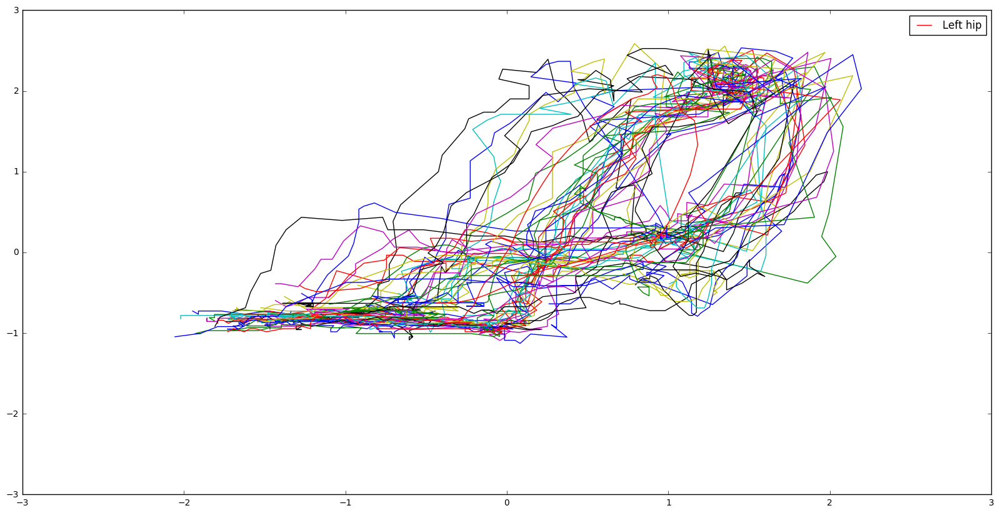

Slider


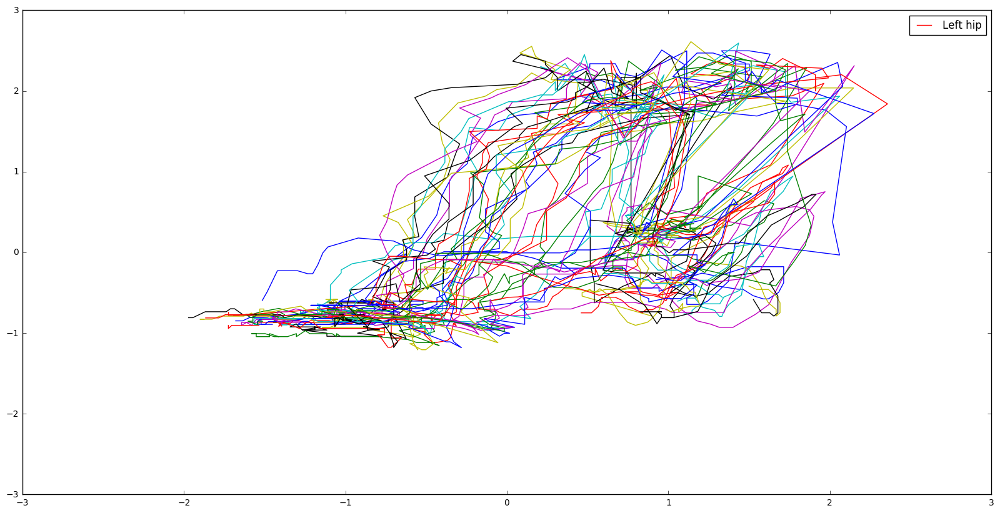

-----------------------------------------------------------------------------
JOINT:  Left knee
Changeup


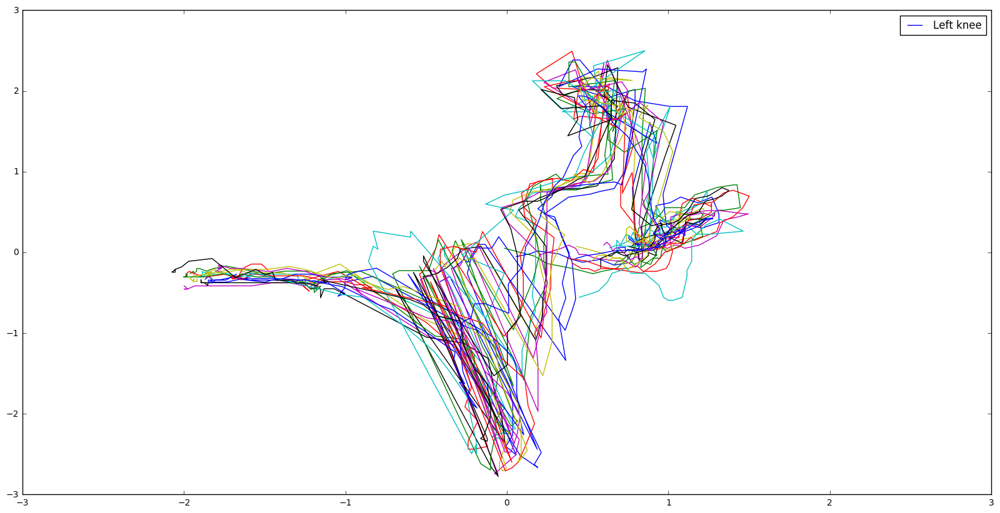

Curveball


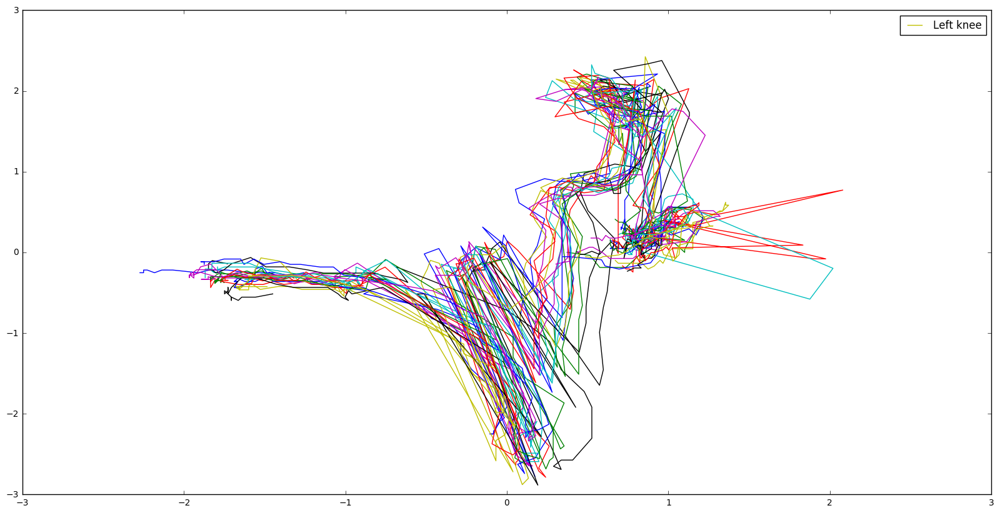

Fastball (2-seam)


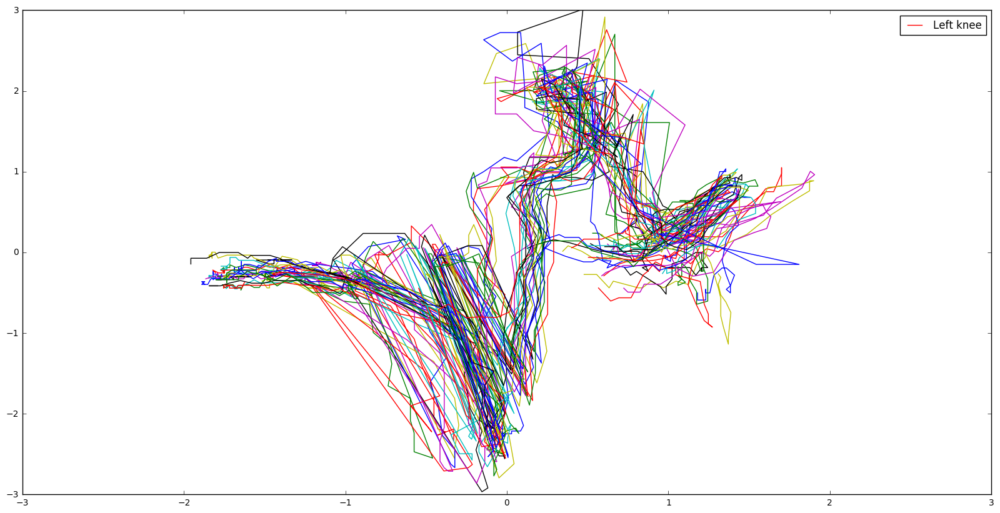

Fastball (4-seam)


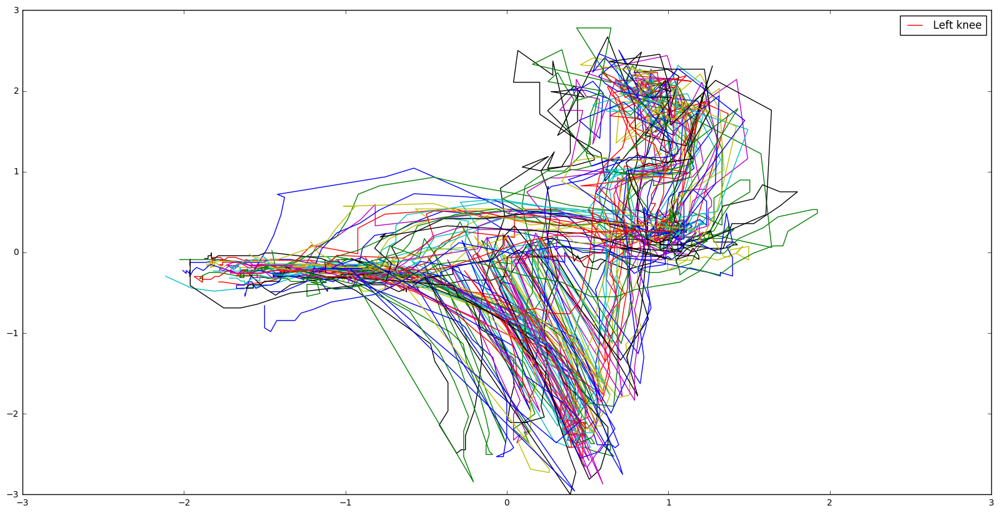

Slider


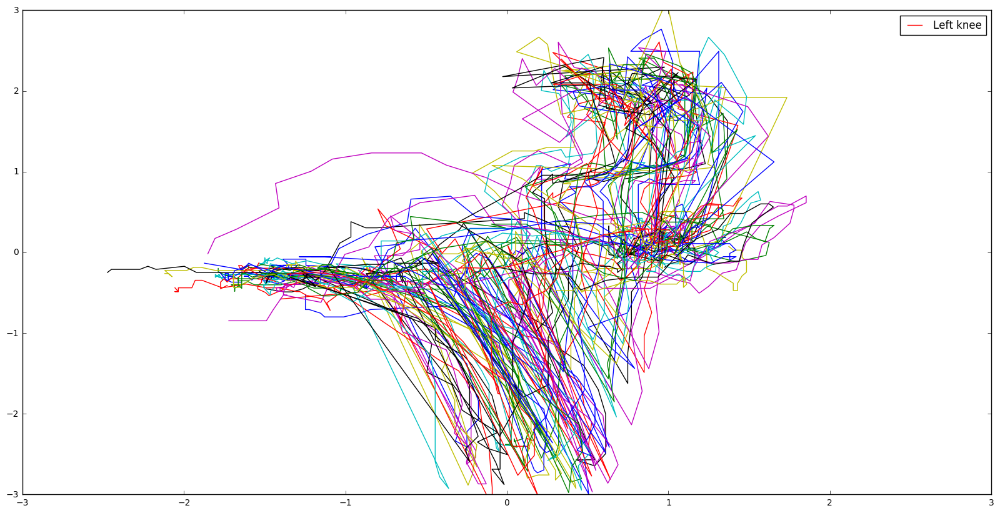

-----------------------------------------------------------------------------
JOINT:  Left ankle
Changeup


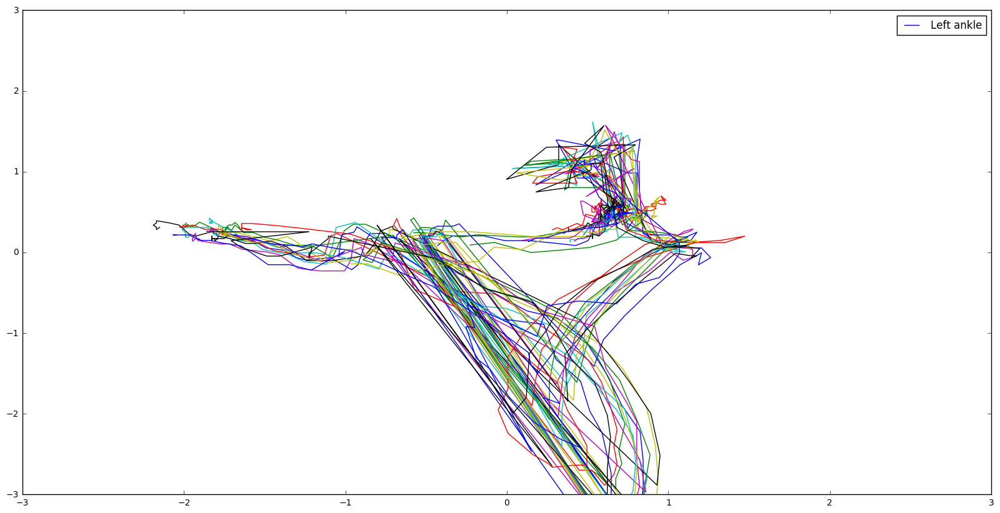

Curveball


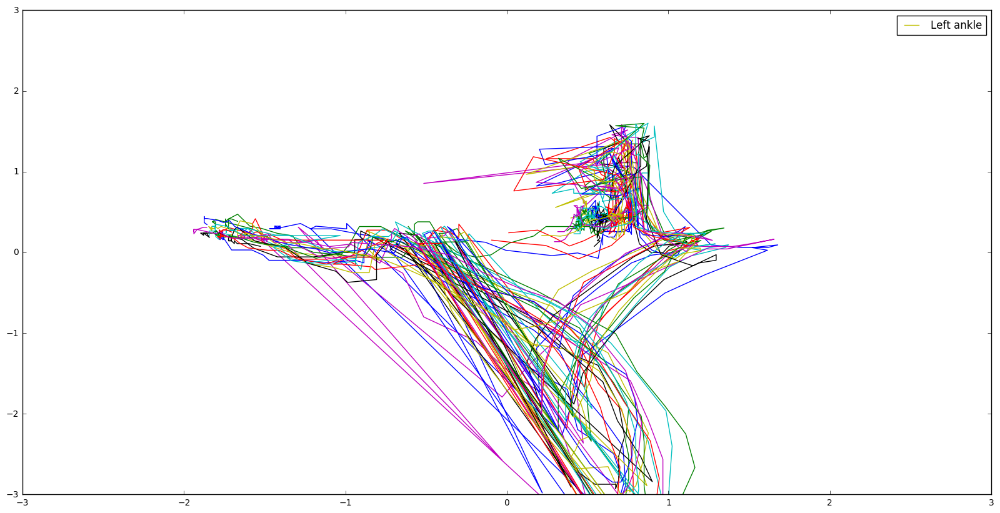

Fastball (2-seam)


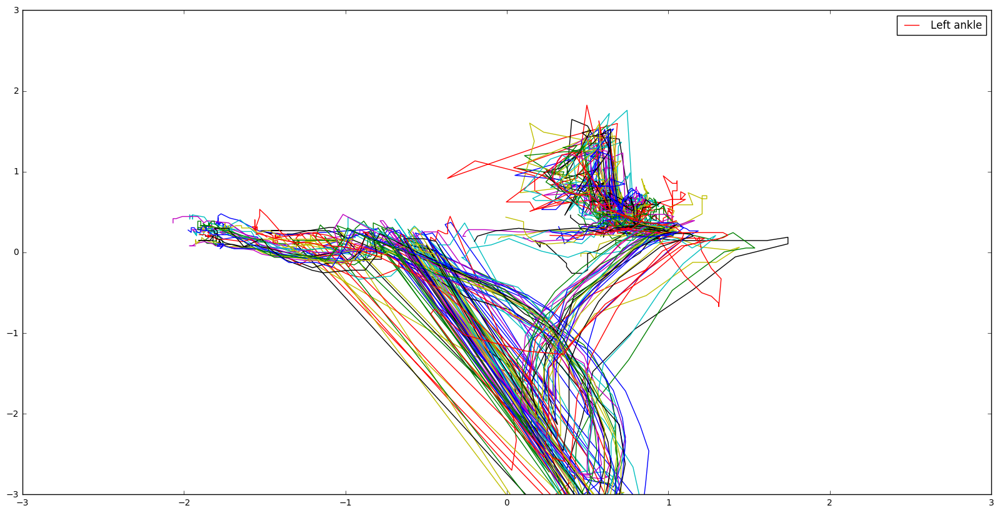

Fastball (4-seam)


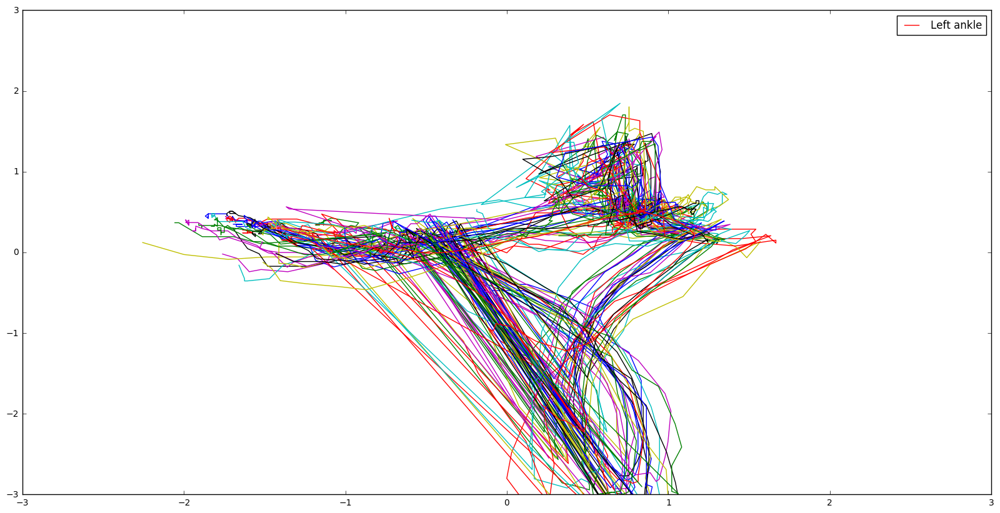

Slider


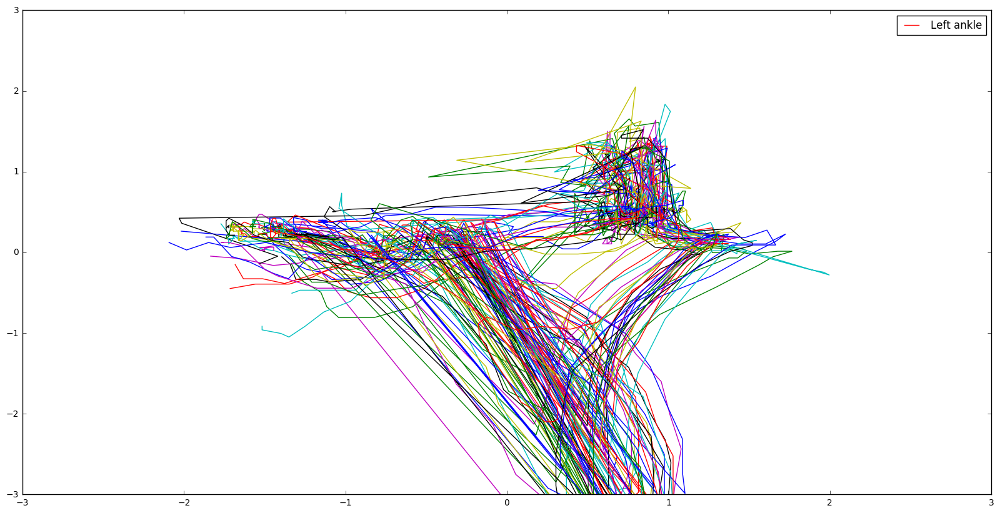

In [92]:
import matplotlib.pylab as plt
joints=["Right shoulder", "Left shoulder", "Right elbow", "Right wrist","Left elbow", "Left wrist",
        "Right hip", "Right knee", "Right ankle", "Left hip", "Left knee", "Left ankle", "Neck ", 
        "Right eye", "Right ear","Left eye", "Left ear"]
from tools import Tools
aligned = Tools.align_frames(data, pre.get_release_frame(60, 120), 60, 40)
aligned = Tools.normalize(aligned)
ALIGNING = True
ERRORBAR = False
START_JOINT = 0
NR_JOINTS = 12
nr_examples = len(data) # 100
cutoff_example_nr = 30

meansX = np.zeros((len(index_liste), NR_JOINTS))
meansY = np.zeros((len(index_liste), NR_JOINTS))
errorX = np.zeros((len(index_liste), NR_JOINTS))
errorY = np.zeros((len(index_liste), NR_JOINTS))

for i in range(NR_JOINTS):
    print("-----------------------------------------------------------------------------")
    print("JOINT: ", joints[i])
    #print(unique[j],"std_sum: ", stds, "anzahl: ", len(frame))
    #print(unique[0], len(frame))
    #print(len(np.mean(frame[:, :, 6+i,1], axis = 0)))
    
    for j in range(len(index_liste)):
        stds = 0
        nr_examples = len(index_liste[j][0])    #100
        index = index_liste[j][0][:nr_examples]
        #print(indizes)
        #print(len(frame))
        if ALIGNING:
            frame = aligned[index]
        else:
            frame = data[index]
        print(unique[j])
        plt.figure(figsize=(20,10))
        x = frame[:, :, START_JOINT+i,1]
        y = frame[:, :, START_JOINT+i,0]
        meX = np.mean(x, axis = 0)
        meY = np.mean(y, axis = 0)
        error = []
        for k, exa in enumerate(x):
            error.append(sum(abs(exa-meX)))
        nr = 0
        for k, exa in enumerate(x):
            if sum(abs(exa-meX))< np.median(error) and nr<cutoff_example_nr:
                plt.plot(exa, y[k])
                nr+=1
        #print(error)
        stdX = np.std(x, axis = 0)
        stdY = np.std(y, axis = 0)
        stds+= np.mean(stdX)+np.mean(stdY)
        plt.plot(meX, meY, label=joints[START_JOINT+i])
        if ERRORBAR:
            plt.errorbar(meX, meY, yerr = stdY, xerr = stdX, label=joints[START_JOINT+i])
        plt.ylim(-3, 3)
        plt.xlim(-3, 3)
        plt.legend()
        plt.show()

## Results
STD is a bit smaller if videos are aligned

# 3. Testing different interpolation/smoothing

In [20]:
data = np.load("unpro_all_coord.npy")
import matplotlib.pylab as plt
from scipy import interpolate
from scipy import ndimage
from tools import Tools

[ 1.0148112   1.0148112   0.83619872  0.83619872  0.89573622  0.92550496
  1.0148112   0.98504245  1.25296117  1.49111113 -0.58762634  1.25296117
  1.43157364  1.4018049   1.37203615  1.16365493  1.0148112   0.95527371
  1.16365493  1.25296117]


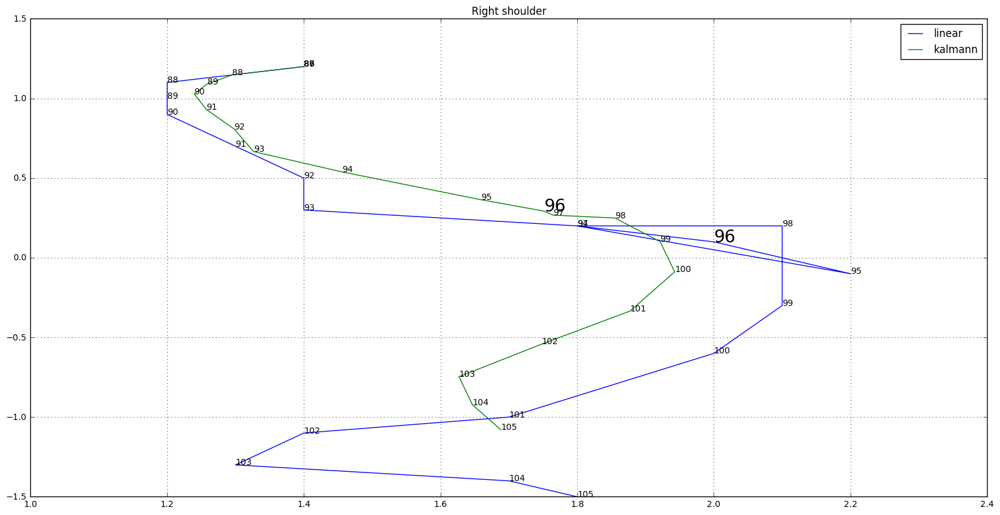

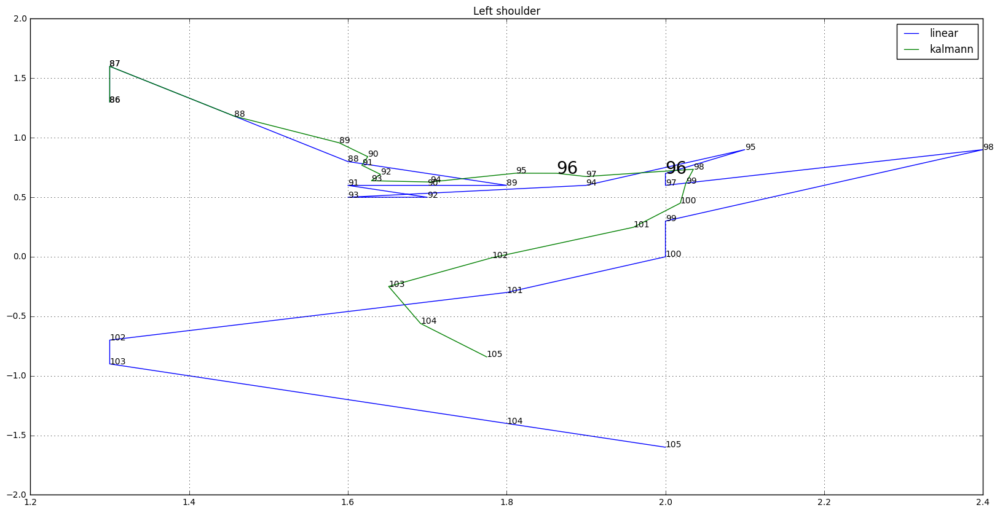

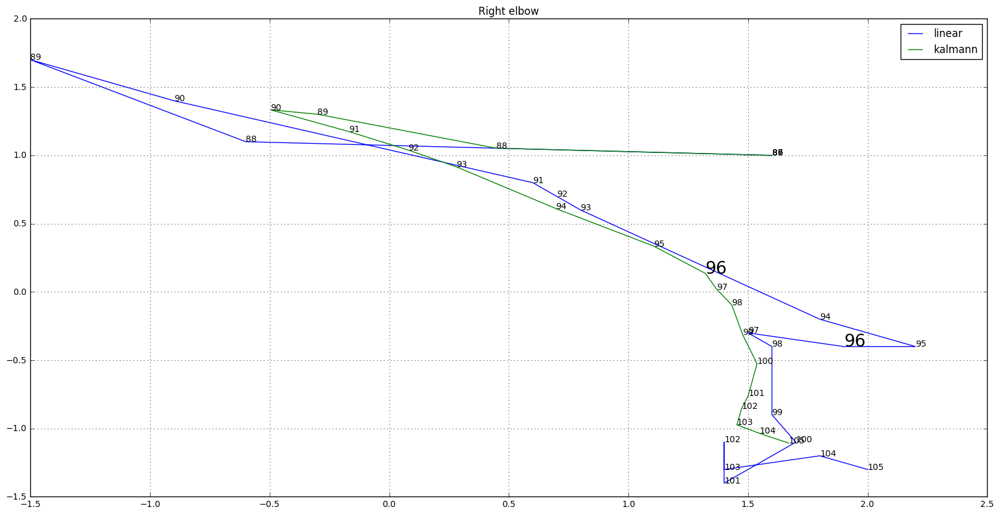

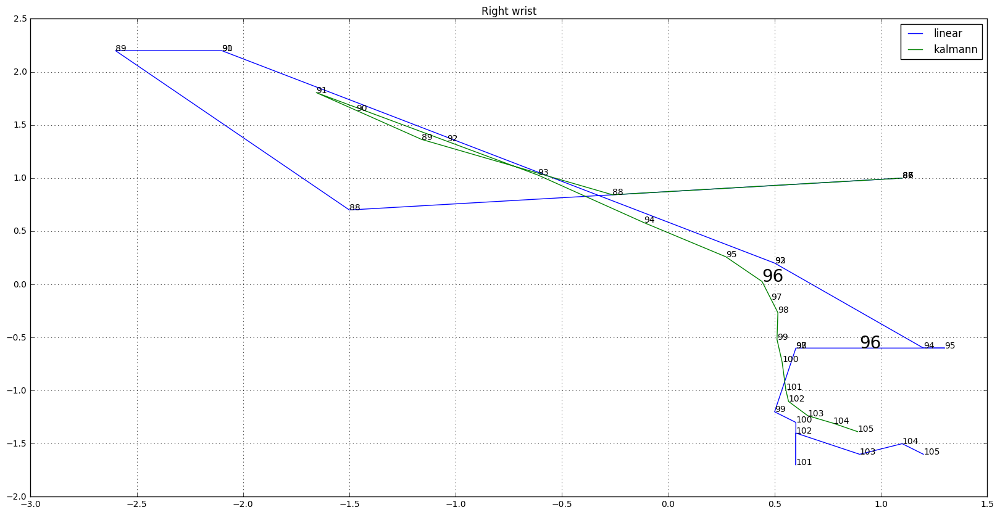

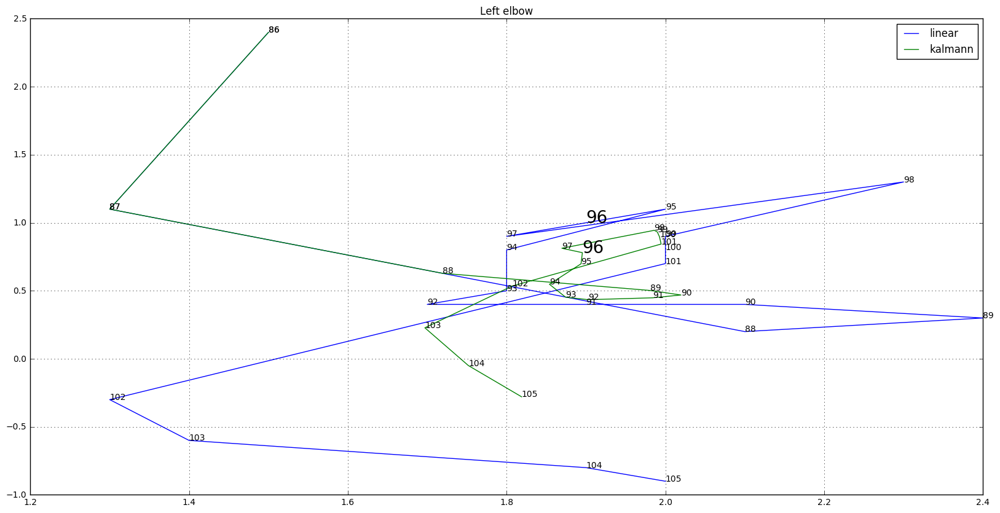

...

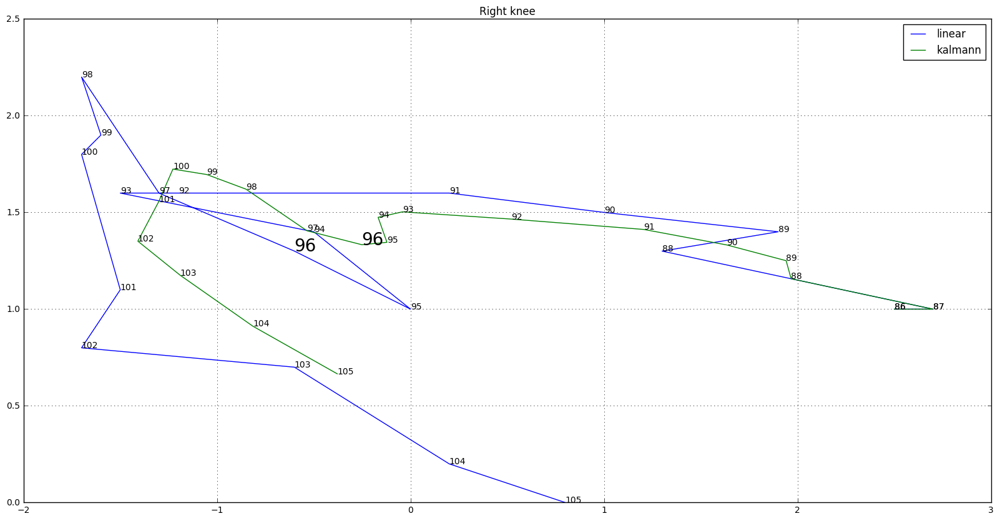

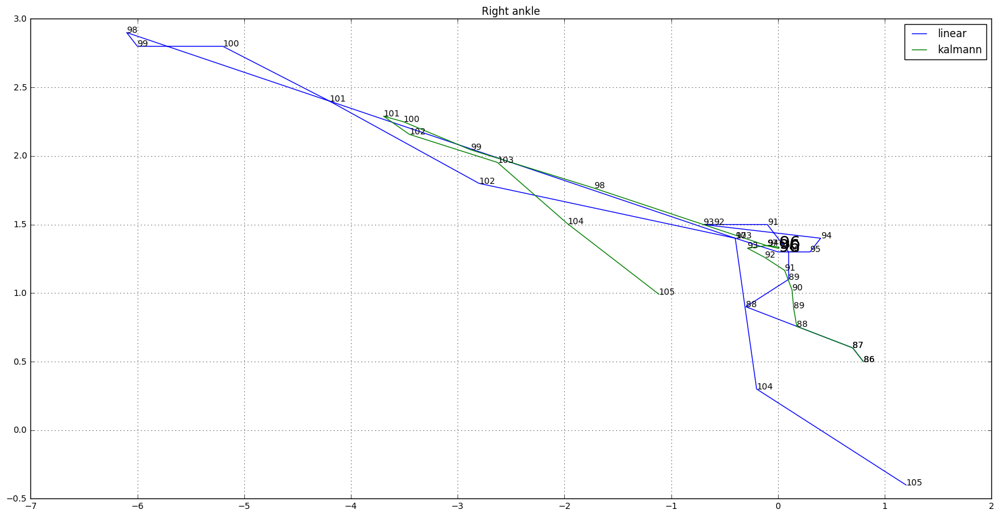

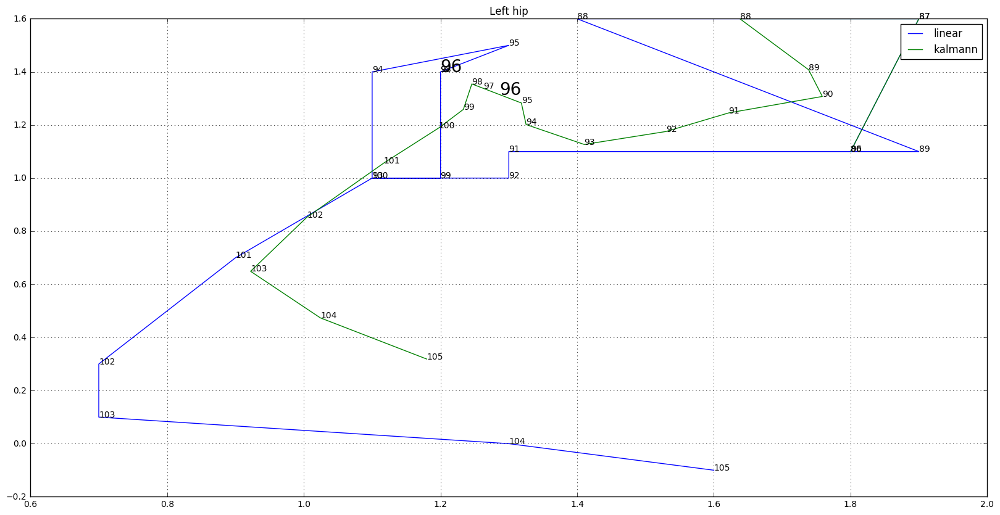

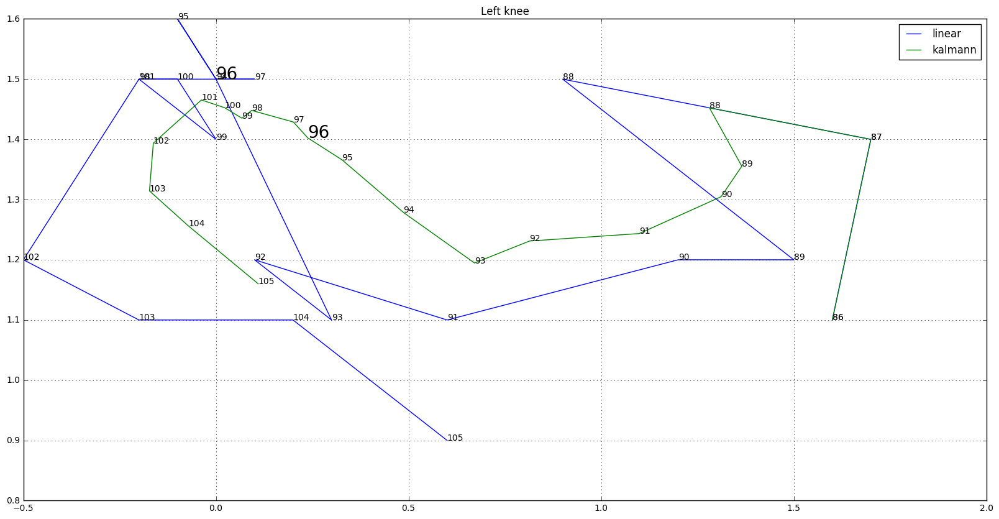

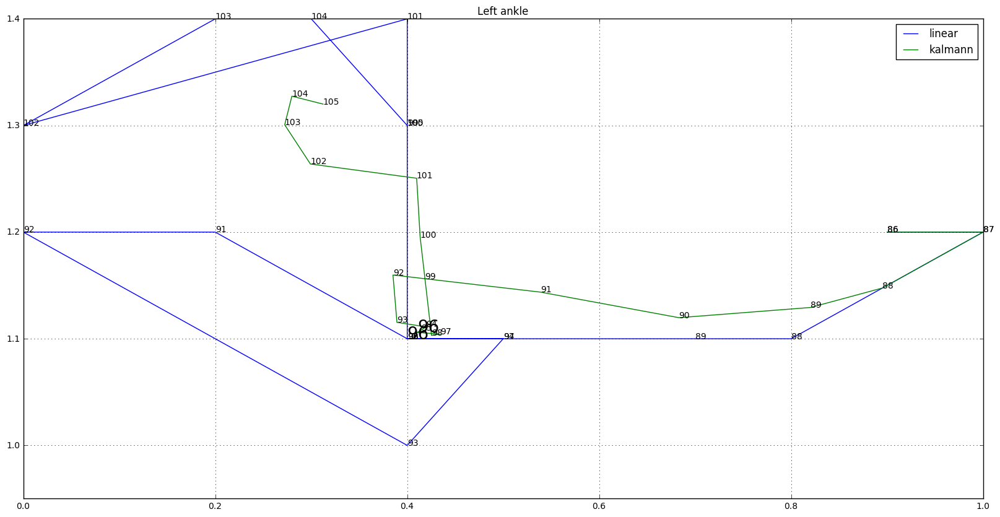

In [38]:
joints=["Right shoulder", "Left shoulder", "Right elbow", "Right wrist","Left elbow", "Left wrist",
        "Right hip", "Right knee", "Right ankle", "Left hip", "Left knee", "Left ankle", "Neck ", 
        "Right eye", "Right ear","Left eye", "Left ear"]
#print(data[540, 92:95])
norm = Tools.normalize(data)
possible_interpo = ["linear", "nearest", "zero", "slinear", "quadratic", "cubic’ where ‘zero", "cubic"]
inter = 6
DATA_EX = 795 # 773 96, 796 94, 803 98
FRAME = 96
RANGE = 10
START = FRAME-RANGE
END = FRAME+RANGE
START_JOINT = 0
example = np.array(norm[DATA_EX])
linear = example.copy()
cubic = example.copy()
smooth = example.copy()
kal = example.copy()
ml = example.copy()
not_zer = np.where(data[DATA_EX, START:END, 1, 0]!=0)[0]
N,j, co = example.shape
smo2 = np.zeros((N*2, j, co))
indices = np.arange(0, END-START, 1)
ind_twice = np.arange(0, (END-START)-0.5, 0.5)
"""
# ML FILL IN
sequ = np.delete(data[:, FRAME-10:FRAME+10], 20//2, axis=1)[:, :, :12, :]
sequ = Tools.normalize(sequ)[DATA_EX]
sequ_around = np.reshape(sequ, (1, len(sequ), 24))
print(sequ_around.shape)
"""
#print(sequ_around)
plot = ["linear", "kalmann"]

ml = np.load("ml_predict.npy")
print(ml[START:END, 0, 0])

for i in range(12):
    for j in range(2):
        #print(not_zer, example[not_zer+START, i,j], indices)
        #print(not_zer*2, example[not_zer+START, i,j], ind_twice)
        f = interpolate.interp1d(not_zer, example[not_zer+START, i,j], kind=possible_interpo[inter])
        cubic[START:END, i, j] = np.round(f(indices), 1)
        new = np.round(np.interp(indices, not_zer, example[not_zer+START,i,j]),1)
        new2= interpolate.interp1d(not_zer, example[not_zer+START, i,j], kind=possible_interpo[inter])
        linear[START:END, i, j] =  new
        smooth[START:END, i, j] = ndimage.filters.gaussian_filter1d(new, sigma = 1)
        #smo2[(START-RANGE):(END+RANGE)-1, i, j]= np.round(f(ind_twice),1)
        kal[START:END, i, j] = kalmann(new)[1]
        # ml[FRAME] = np.reshape(get_ML_coord(sequ_around)[0], (12,2))
    fig = plt.figure(figsize = (20,10))
    ax = fig.add_subplot(111)
    dic = {"linear": [linear[START:END, i, 0], linear[START:END, i, 1]], 
           "kalmann": [kal[START:END, i, 0], kal[START:END, i, 1]], 
          "cubic": [cubic[START:END, i, 0], cubic[START:END, i, 1]],
          "gaussian_filter": [smooth[START:END, i, 0], smooth[START:END, i, 1]],
          "twice_values": [smo2[START-RANGE:END+RANGE-1, i, 0], smo2[START-RANGE:END+RANGE-1, i, 1]],
          "ML_fill_in": [ml[START:END, i, 0], ml[START:END, i, 1]]}
    for kind in plot:
        meX = dic[kind][0]
        meY = dic[kind][1]   
        plt.plot(meX, meY, label= kind)
        for k in range(START,END): 
            if k==FRAME:
                ax.annotate(str(k), (meX[k-START], meY[k-START]), size=20)
            else:
                ax.annotate(str(k), (meX[k-START], meY[k-START]))
    plt.title(joints[i+START_JOINT])
    plt.grid()
    plt.legend()
    plt.show()
    

## ML coord fill in

In [5]:
from model import Model
import tflearn
from tflearn import DNN

In [24]:
def get_ML_coord(sequ_around):
    nr_layers = 4
    n_hidden = 512
    BATCHSIZE = 128
    EPOCHS = 50
    SEQU_LEN = 20
    dropout = 0
    _, fr, input_size = sequ_around.shape
    model = Model()
    out, network = model.RNN_network_tflearn(fr, input_size, input_size, nr_layers, n_hidden, dropout, loss = "mean_square", act = "tanh")
    m = DNN(network, checkpoint_path='sequ/model.tfl.ckpt')
    print("dnn")
    m.load("./sequ/model.tfl")
    print("loaded")
    out = m.predict(sequ_around)
    return out

## Kalmann filtering

20


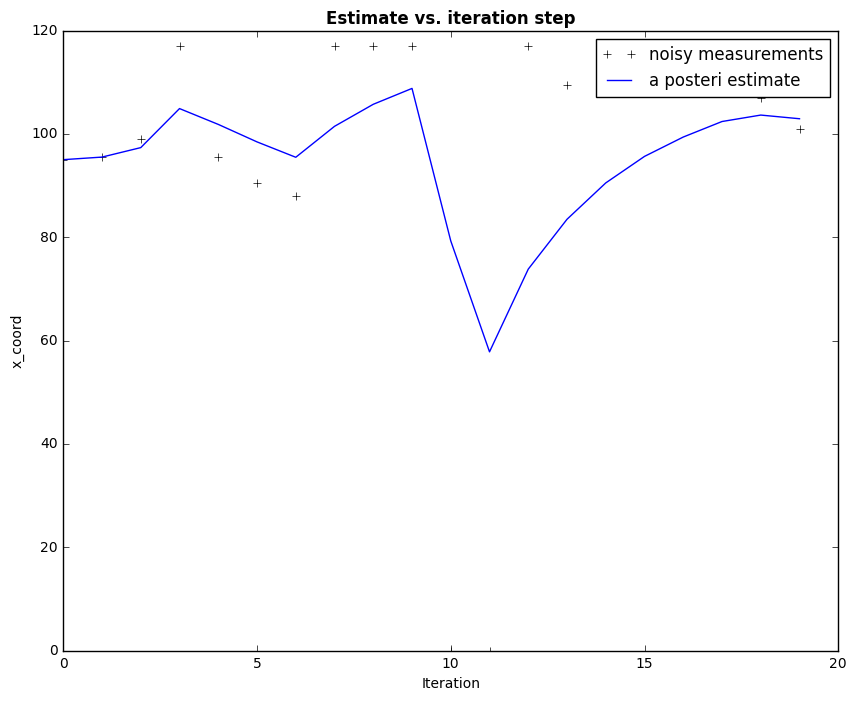

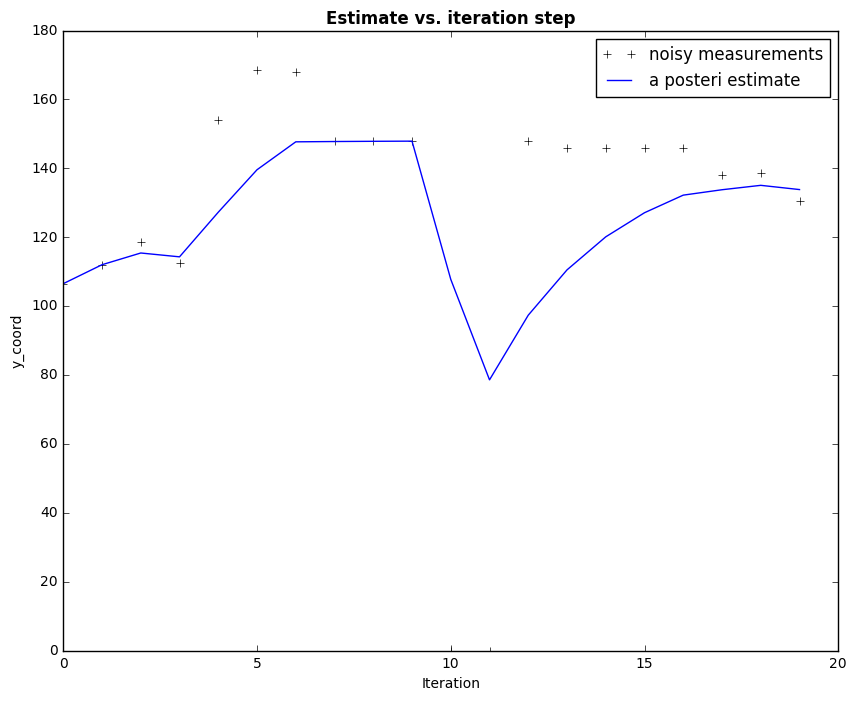

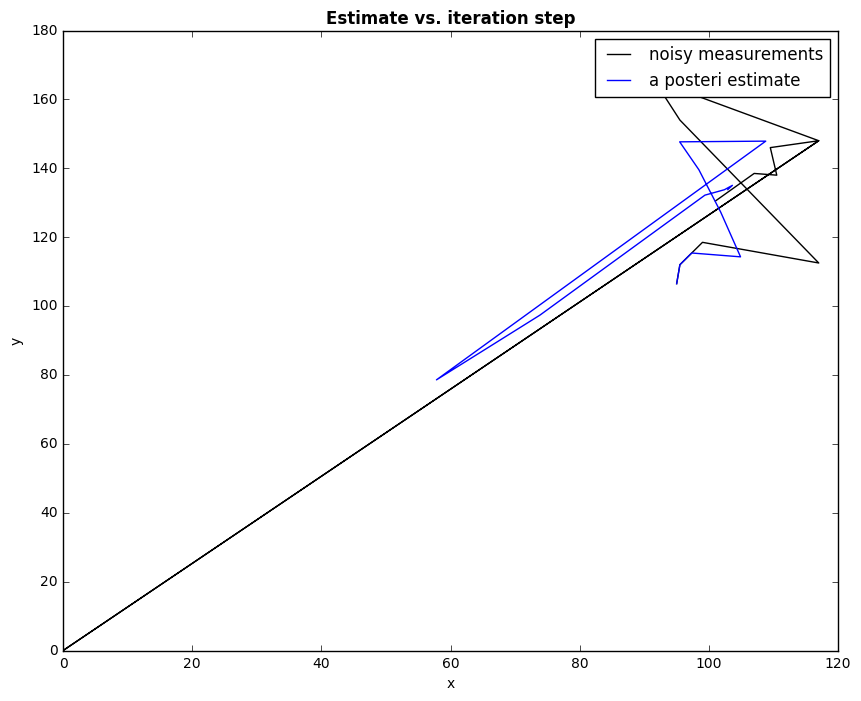

In [7]:
# KALMANN IS TOO SLOW

bsp_sequ_x = linear[START:END, 3, 0]
bsp_sequ_y = linear[START:END, 3, 1]
print(len(bsp_sequ_x))

"""plt.figure()
plt.plot(bsp_sequ_x, bsp_sequ_y, label = "before_filtering")
plt.show()"""

plt.rcParams['figure.figsize'] = (10, 8)

def kalmann(sequence):
    # intial parameters
    n_iter = len(sequence)
    sz = (n_iter,) # size of array
    #x = -0.37727 # truth value (typo in example at top of p. 13 calls this z)
    z = sequence #np.random.normal(x,0.1,size=sz) # observations (normal about x, sigma=0.1)

    Q = 1e-5 # process variance

    # allocate space for arrays
    xhat=np.zeros(sz)      # a posteri estimate of x
    P=np.zeros(sz)         # a posteri error estimate
    xhatminus=np.zeros(sz) # a priori estimate of x
    Pminus=np.zeros(sz)    # a priori error estimate
    K=np.zeros(sz)         # gain or blending factor

    R = 0.1**4 # estimate of measurement variance, change to see effect

    # intial guesses
    xhat[0] = sequence[0]
    P[0] = 1.0

    for k in range(1,n_iter):
        # time update
        xhatminus[k] = xhat[k-1]
        Pminus[k] = P[k-1]+Q

        # measurement update
        K[k] = Pminus[k]/( Pminus[k]+R )
        xhat[k] = xhatminus[k]+K[k]*(z[k]-xhatminus[k])
        P[k] = (1-K[k])*Pminus[k]
    return sequence, xhat

zx, xhatnew = kalmann(bsp_sequ_x)
zy, yhat = kalmann(bsp_sequ_y)

plt.figure()
plt.plot(zx,'k+',label='noisy measurements')
plt.plot(xhatnew,'b-',label='a posteri estimate')
# plt.axhline(x,color='g',label='truth value')
plt.legend()
plt.title('Estimate vs. iteration step', fontweight='bold')
plt.xlabel('Iteration')
plt.ylabel('x_coord')
plt.show()

plt.figure()
plt.plot(zy,'k+',label='noisy measurements')
plt.plot(yhat,'b-',label='a posteri estimate')
# plt.axhline(x,color='g',label='truth value')
plt.legend()
plt.title('Estimate vs. iteration step', fontweight='bold')
plt.xlabel('Iteration')
plt.ylabel('y_coord')
plt.show()

plt.figure()
plt.plot(bsp_sequ_x, bsp_sequ_y,'k-',label='noisy measurements')
plt.plot(xhatnew, yhat, 'b-',label='a posteri estimate')
# plt.axhline(x,color='g',label='truth value')
plt.legend()
plt.title('Estimate vs. iteration step', fontweight='bold')
plt.xlabel('x')
plt.ylabel('y')
plt.show()

## Plot these trajectories in the video

In [39]:
print(data.shape)
from data_preprocess import Preprocessor
prepro = Preprocessor("unprocessed_data.csv")
prepro.remove_small_classes(50)
print(prepro.cf.shape)

(6422, 167, 12, 2)


/Users/ninawiedemann/anaconda/lib/python3.5/site-packages/IPython/core/interactiveshell.py:2821: DtypeWarning: Columns (254,255,256,257,258,259,260,290) have mixed types. Specify dtype option on import or set low_memory=False.
  if self.run_code(code, result):


csv eingelesen with length  13150
Only Pitcher rows
[['Changeup' 491]
 ['Curveball' 627]
 ['Eephus' 1]
 ['Fastball (2-seam)' 1341]
 ['Fastball (4-seam)' 2075]
 ['Fastball (Cut)' 287]
 ['Fastball (Split-finger)' 49]
 ['Knuckle curve' 73]
 ['Knuckleball' 350]
 ['Sinker' 265]
 ['Slider' 913]
 ['Unknown Pitch Type' 103]]
Removed because not enought class members:  ['Eephus' 'Fastball (Split-finger)'] Unknown Pitch Type
(6422, 445)


In [40]:
print(prepro.cf.iloc[DATA_EX]["Game"])
release = prepro.cf.iloc[DATA_EX]["pitch_frame_index"]
print(release)

import cv2 
import ast
%matplotlib inline
import numpy as np
import matplotlib.pylab as plt
from os import listdir
import pandas as pd

path = "/Volumes/Nina Backup/videos/atl/"
#path_input_dat = "/Volumes/Nina Backup/videos/atl/2017-04-14/center field/490251-0f308987-60b4-480c-89b7-60421ab39106.mp4.dat"


dates = "2017-07-16" #, "2017-04-18", "2017-05-02", "2017-05-06"] # , "2017-05-19", "2017-05-23", "2017-06-06", "2017-06-10", "2017-06-18", "2017-06-22", "2017-07-04", "2017-07-16",
# "2017-04-15", "2017-04-19", "2017-05-03", "2017-05-07", "2017-05-20", "2017-05-24", "2017-06-07", "2017-06-11", "2017-06-19", "2017-06-23", "2017-07-05", "2017-07-17"]
# only first two rows von den im cluster angezeigten
# output_folder=args.output_dir

output = []

file = prepro.cf.iloc[DATA_EX]["Game"] + ".mp4" #491465-1a697776-fcf9-4a5e-817e-c38f975a6ce8.mp4"
input_dir = path+dates+"/center field/"
video_capture = cv2.VideoCapture(input_dir+file)
game_id = file[:-4]

for i in open(input_dir+file+".dat").readlines():
    datContent=ast.literal_eval(i)

bottom_p=datContent['Pitcher']['bottom']
left_p=datContent['Pitcher']['left']
right_p=datContent['Pitcher']['right']
top_p=datContent['Pitcher']['top']
bottom_b=datContent['Batter']['bottom']
left_b=datContent['Batter']['left']
right_b=datContent['Batter']['right']
top_b=datContent['Batter']['top']
#center_dic['Pitcher']=np.array([abs(top_p-bottom_p)/2., abs(left_p-right_p)/2.])
#center_dic['Batter']=np.array([abs(top_b-bottom_b)/2., abs(left_b-right_b)/2.])
frames = np.zeros((167, 221, 290, 3))
i = 0
while True:
    ret, frame = video_capture.read()
    if frame is None:
        break
    pitcher = frame[top_p:bottom_p, left_p:right_p]
    # batter = frame[top_b:bottom_b, left_b:right_b]
    frames[i]= pitcher
    i+=1

output.append(frames)

491465-1a697776-fcf9-4a5e-817e-c38f975a6ce8
97.0


FileNotFoundError: [Errno 2] No such file or directory: '/Volumes/Nina Backup/videos/atl/2017-07-16/center field/491465-1a697776-fcf9-4a5e-817e-c38f975a6ce8.mp4.dat'

In [ ]:
""" RED POINTS ARE SMOOTHED, GREEN UNPROCESSED"""
vid = output[0]
print(vid.shape)
print(release)
for i in range(START, END):
    print(i)
    if i==release:
        print("BALL RELEASE FRAME")
    for j in range(12):
        x = linear[i, j, 0]
        y = linear[i,j,1]
        vid[i,int(x)-2:int(x)+2, int(y)-2:int(y)+2]=[1,0,0] # red
        x = kal[i, j, 0]
        y = kal[i,j,1]
        vid[i,int(x)-2:int(x)+2, int(y)-2:int(y)+2]=[0,0,1] # blue
        x = example[i, j, 0]
        y = example[i,j,1]
        vid[i,int(x)-2:int(x)+2, int(y)-2:int(y)+2]=[0,1,0] # green : normal
    plt.imshow(vid[i])
    plt.show()

## Test deep learning coordinate prediction

[-1.95698294 -1.3046553  -1.3046553  -1.3046553  -1.3046553  -0.97849147
 -0.65232765  0.          0.          0.          0.65232765  0.65232765
  0.65232765  0.97849147  0.97849147  0.97849147  0.97849147  0.97849147
  0.97849147] 0.649953 0.978491471283


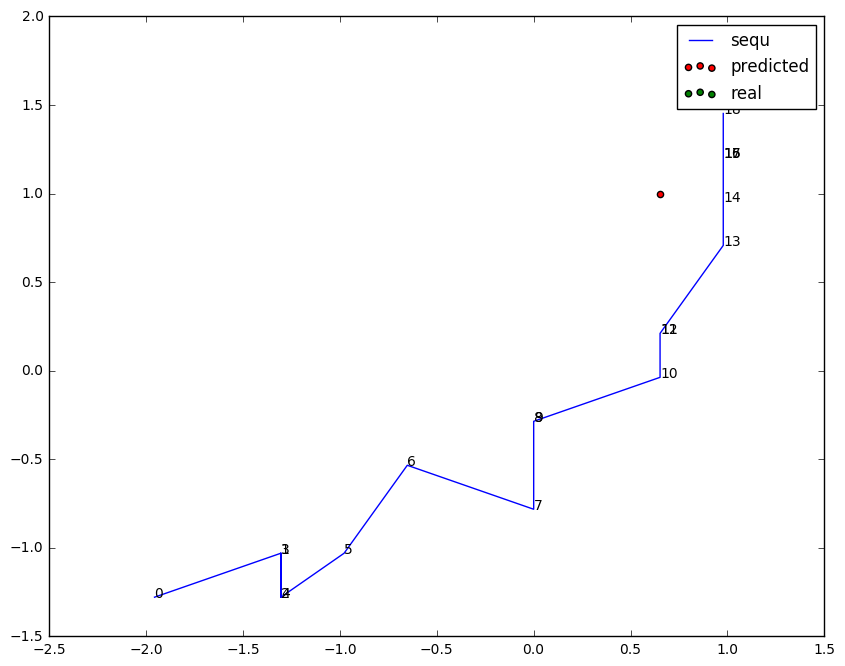

[-1.92624468 -1.51199851 -1.51199851 -1.51199851 -1.09775234 -0.68350618
 -0.68350618  0.14498616  0.14498616  0.55923233  0.97347849  0.97347849
  0.97347849  0.97347849  0.97347849  0.97347849  0.55923233  0.55923233
  0.55923233] 0.458693 0.559232326081


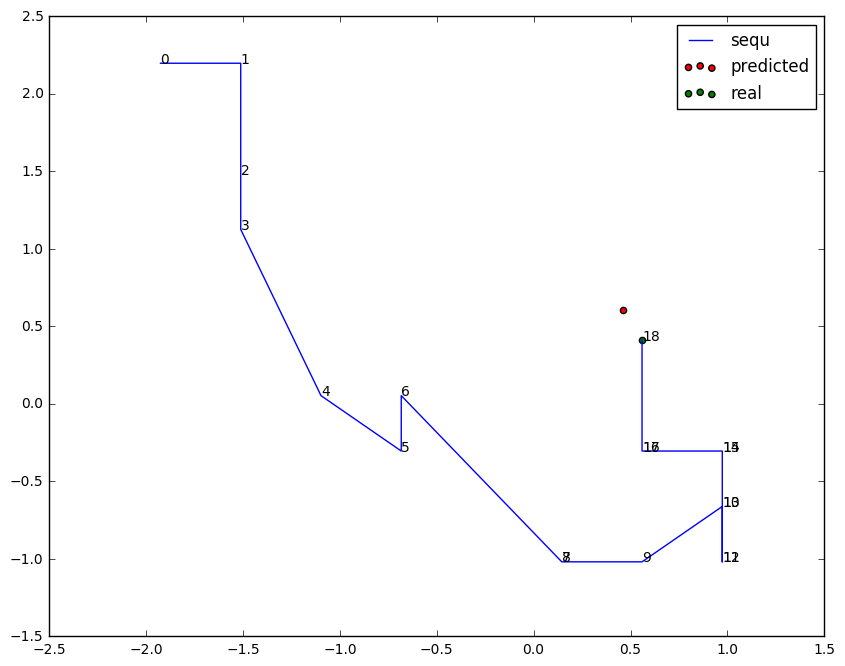

[-1.37500273 -1.15846687 -1.15846687 -1.15846687 -1.15846687 -0.94193101
 -0.72539514 -0.29232342 -0.50885928 -0.29232342  0.14074831  0.14074831
  0.35728418  0.35728418  0.7903559   1.00689177  1.43996349  1.43996349
  1.65649936] 0.991018 1.43996349374


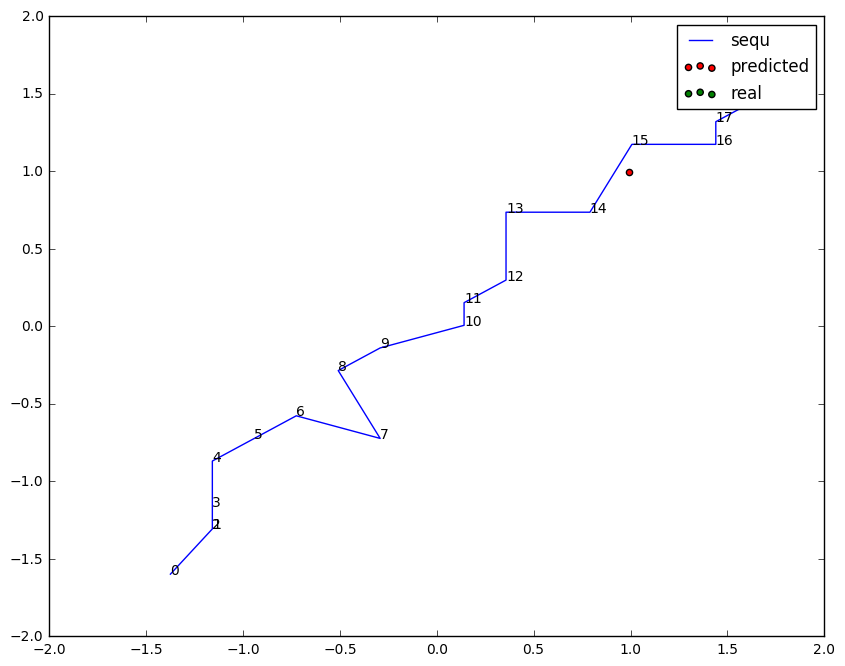

[-0.68955424 -0.8518023  -1.17629841 -0.8518023  -0.8518023  -0.8518023
 -0.8518023  -0.8518023  -0.8518023  -0.20281007 -0.04056201 -0.04056201
  0.12168604 -0.04056201  0.2839341   0.77067827  1.58191855  1.58191855
  2.06866272] 0.999412 1.74416660438


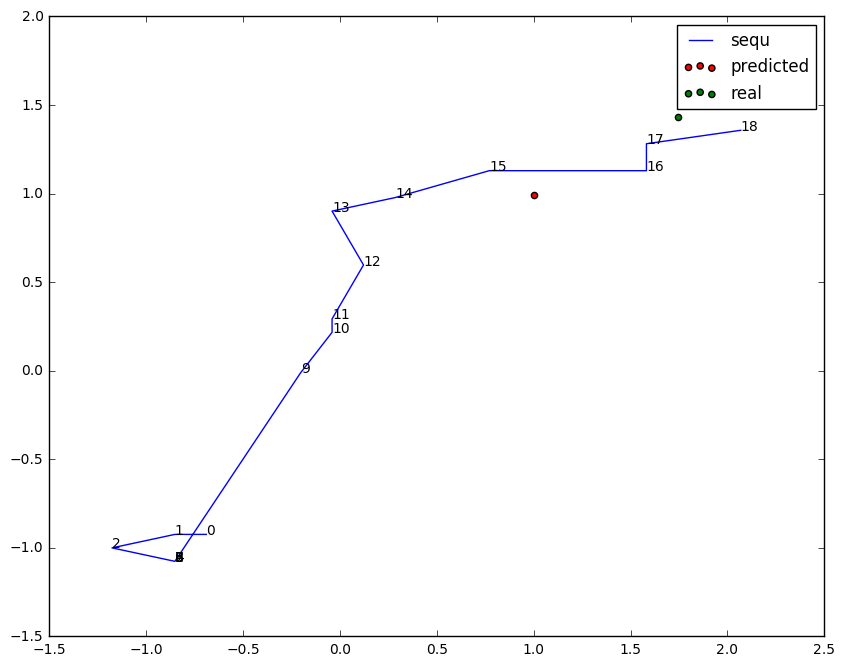

[-1.92842398 -1.43395629 -1.43395629 -1.43395629 -0.44502092  0.04944677
  0.04944677  0.54391446  0.54391446  1.53284983  0.54391446  1.03838214
  2.02731752  0.54391446  0.54391446  0.54391446  0.04944677 -0.44502092
 -0.44502092] -0.507884 -0.445020918693


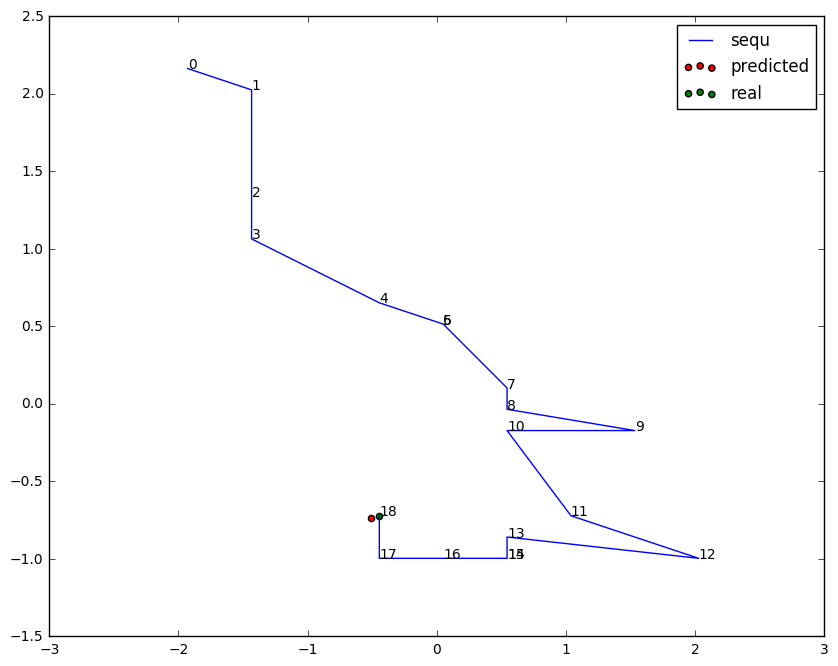

[-1.43663543 -0.89450885 -0.62344556 -0.62344556 -0.08131899  1.27399745
  1.00293417  1.27399745  1.81612403  1.81612403 -0.62344556  0.1897443
  1.27399745 -0.35238227 -0.35238227 -0.35238227 -0.35238227 -0.89450885
 -0.89450885] -0.948304 -1.16557213823


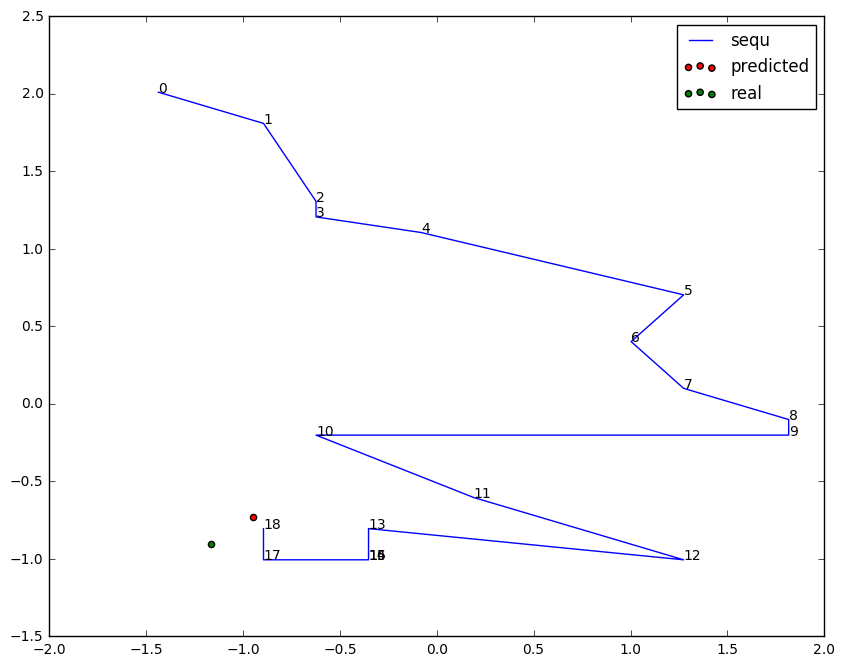

In [30]:
import numpy as np
import matplotlib.pylab as plt
import matplotlib.cm as cm
bsp = 18
s1 = np.load("sequ/seque_coord.npy")[bsp]
p1 = np.load("sequ/out_coord.npy")[bsp]
r1 = np.load("sequ/real_coord.npy")[bsp]
"""s1 = sequ[0]
s2 = sequ[1]
p1 = predicted[0]
p2 = predicted[1]"""
#print(s1, p1)
#fig = plt.figure(figsize=(20,10))
#print(s1.shape, p1.shape)
for i in range(6):
    print(s1[:, 2*i], p1[2*i], r1[2*i])
    ax = plt.subplot(111)
    ax.plot(s1[:, 2*i], s1[:, 2*i+1], label = "sequ")
    for k in range(len(s1)):
        ax.annotate(str(k), (s1[k, 2*i], s1[k, 2*i+1]))
    ax.scatter(p1[2*i], p1[2*i+1], c="red", label = "predicted")
    ax.scatter(r1[2*i], r1[2*i+1], c="green", label = "real")
    ax.legend()
    plt.show()

# 4. Create one script for video-to-pitchtype processing

In [ ]:
"""
Problems: pytorch and tensorflow are somehow incompatible - once a pytorch model is started, 
creating a tensorflow session leads to a coredump because of an internal python memory error 
"""
('shape', (1, 167, 18, 2))
('Time to read in video and handle one:', 57.31005096435547)
('nach handle one shape --> all detected people in the frame', (167, 12, 18, 2))
('time for df_coordinates (selecting right player, fill in missing values...)', 27.217700958251953)
('shape input for ANN', (1, 167, 18, 2))
('Time for whole video to array step: ', 84.64371180534363)
('Time for array load and runner', 1.3805208206176758)
('predicted', ['Fastball (2-seam)'], 'truth', array(['Fastball (2-seam)'],dtype='|S17'), 'accuracy', 1.0
 
 OR:
 
 ('Time to read in video and handle one:', 61.53413200378418)
('time for df_coordinates', 31.455853939056396)
('shape', (1, 167, 18, 2))
('Time for array load and runner', 1.4578359127044678)
('vorhergesagt', ['Sinker'], 'truth', array(['Sinker'], dtype='|S6'), 'accuracy', 1.0
 
 Specific times:
 ('handle one1', 5.793571472167969e-05)
('handle one 2', 0.1919260025024414)
('handle one 3', 0.4836001396179199)
('handle one 4', 0.0747530460357666)
('handle one 5', 0.017817020416259766)
('handle one 6', 0.00047397613525390625)
 ('handle one1', 2.002716064453125e-05)
('handle one 2', 0.002607107162475586)
('handle one 3', 0.10315203666687012)
('handle one 4', 0.0741269588470459)
('handle one 5', 0.018039941787719727)
('handle one 6', 0.0005102157592773438)
 ('Time to read in video and handle one:', 61.37848711013794)
('Time for player_localization: ', 0.08333992958068848)
('Time for player_localization: ', 0.05714106559753418)
('Time for player_localization: ', 0.050184011459350586)
 ('Time for mix right left', 0.025226116180419922)
('Time for mix right left', 0.0242462158203125)
('Time for mix right left', 0.02407217025756836)
('Time for mix right left', 0.02440786361694336)
 ('Time for continuity ', 8.715142965316772)
('Time for continuity ', 8.832612991333008)
('time for df_coordinates', 35.55333495140076)
('Time for whole video to array: ', 97.31024312973022)
('Time for array load and runner', 1.3065440654754639)
('vorhergesagt', ['Sinker'], 'truth', array(['Sinker'], dtype='|S6'), 'accuracy', 1.0)
 --> Continuity is slow and does not work well